# Advanced Lane Finding Project

The goals / steps of this project are the following:
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import glob
import cv2
import os
import copy
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import moviepy
from moviepy.editor import VideoFileClip
import sklearn
from sklearn.linear_model import RANSACRegressor
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline




OUT = "output_images"
CACHE = "cache"
road_file = 'test_images/straight_lines1.jpg'
    
show = True
save = True

# %load_ext line_profiler

# Hyperparameters

In [48]:
sobel_anomaly_percentile = 99.9
l_intensity_anomaly_percentile = 99.5
b_intensity_anomaly_percentile = 99

trapezoid_params = {"x_l": 0.1, "x_h": 0.45, "y_h":0.95, "y_l": 0.6}
trapezoid_params_flat = {"x_l": 0.1, "x_h": 0.1, "y_h":0.95, "y_l": 0.2}


# Auxilery functions

In [38]:
def setup_figure(m_pics, w, h, n=10):
    return plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))        


def white_balance(image):
    # https://pippin.gimp.org/image-processing/chapter-automaticadjustments.html
    lab_image = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    avg_a = np.average(lab_image[:, :, 1])
    avg_b = np.average(lab_image[:, :, 2])
    L = lab_image[:,:,0] / 255.
    lab_image[:, :, 1] = lab_image[:, :, 1] - (np.average(lab_image[:, :, 1]) - 128) * L * 1.1
    lab_image[:, :, 2] = lab_image[:, :, 2] - (np.average(lab_image[:, :, 2]) - 128) * L * 1.1
    image_out = cv2.cvtColor(lab_image, cv2.COLOR_LAB2RGB)

    image[:] = image_out


        
def draw_lines(img, lines, color=[255, 0, 0], thickness=2, lanes_input=False):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    
    if lanes_input:
        dynamic = False
        Y, X = img.shape[:2]
        lines_df = pd.DataFrame(np.squeeze(lines), columns=["x1", "y1", "x2", "y2"])
        lines_df["angle"] = lines_df.apply(lambda row: np.arctan2(row.y2 - row.y1, row.x2 - row.x1), axis="columns")

        lanes = {}
        for angle_sign in [-1,1]:
            filt = (np.sign(lines_df.angle) == angle_sign)

            x_ = lines_df[filt].x1.tolist() + lines_df[filt].x2.tolist()
            y_ = lines_df[filt].y1.tolist() + lines_df[filt].y2.tolist() 
            poly1d = np.polyfit(y_, x_, deg=1)
            width = 20
            if dynamic:
                # rotate to find width
                angle = lines_df.loc[filt, "angle"].mean()

                dx = lines_df.loc[filt, "x2"] - lines_df.loc[filt, "x1"]
                dy = lines_df.loc[filt, "y2"] - lines_df.loc[filt, "y1"]
                xr = dx * np.sin(angle) + dy * np.cos(angle) 
                yr = -dx * np.cos(angle) + dy * np.sin(angle) 

                if len(xr) == 1:
                    width = 20
                else:
                    width = min(int(np.std(xr)), 20)

            lanes[angle_sign] = {"poly": poly1d, "min": min(y_), "width": width}


        y_min = min(lanes[-1]["min"], lanes[1]["min"])
        for lane in lanes:
            p = lanes[lane]["poly"]
            pts = (np.polyval(p, Y), Y, np.polyval(p, y_min), y_min)
            cv2.line(img, (int(pts[0]), int(pts[1])), (int(pts[2]), int(pts[3])), color=[255, 0, 0], thickness=width)
                
    else:
        for line in lines:
            for x1,y1,x2,y2 in line:
                cv2.line(img, (x1, y1), (x2, y2), color, thickness)


# 1. Camera calibration


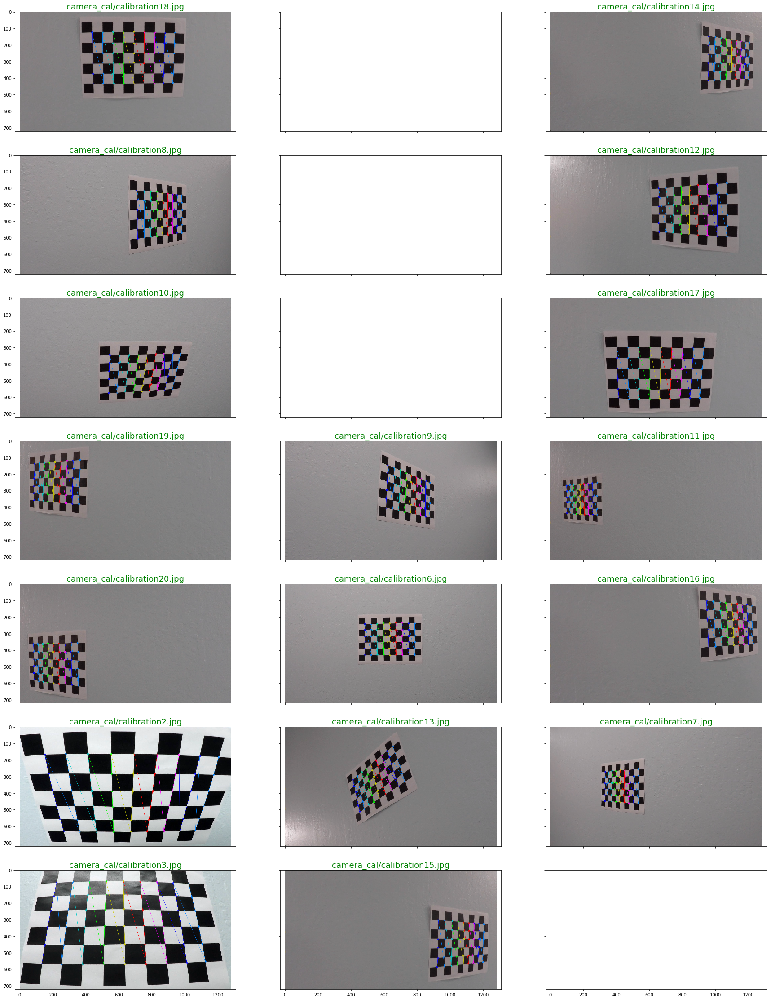

In [4]:
from pdb import set_trace as bp
class chessboard(object):
    
    def __init__(self, img_file, rows, cols, show=False, save=False, axes=None):
        self.img_file = img_file
        try:
            with open(self.img_file) as fd:
                self.img = cv2.imread(calib_file)
            self.gray = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)                
        except Excption as ex:
            print(ex)
            raise
        
        self.rows = rows
        self.cols = cols
        self.save = save
        self.show = show
        self.axes = axes

        
    @property
    def shape(self):
        return self.img.shape

    def findChessboardCorners(self):
        found, corners = cv2.findChessboardCorners(self.gray, (self.rows, self.cols), None)
        if not found:
            return None
            
            #raise Exception('{} not chessboard corners found'.format(self.img_file))
        
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        corners = cv2.cornerSubPix(image=self.gray, corners=corners, winSize=(7, 7), zeroZone=(-1, -1), criteria=criteria)
        
        if self.show or self.save:
            img = self.img.copy()
            cv2.drawChessboardCorners(img, (self.rows, self.cols), corners, found)
            
            if self.show:
                self.axes.imshow(img)
                self.axes.set_title(self.img_file, color='g', fontsize=18)

            if self.save:
                cv2.imwrite("{}/1_chessboard_{}".format(OUT, os.path.split(self.img_file)[-1]), img)
                
        return corners
    
always_show_chessboard = True
cols, rows = 9, 6
object_points = np.zeros((rows * cols, 3), np.float32)
object_points[:, :2] = np.mgrid[:rows, :cols].T.reshape(-1,2)


calibration_cache_file = '{}/calib.npz'.format(CACHE)
decalibration_cache_file = '{}/decalib.npz'.format(CACHE)

if not os.path.exists(calibration_cache_file) or always_show_chessboard:
    if show:
        f, axes = plt.subplots(7, 3, squeeze=True, sharex=True, sharey=True, figsize=(30, 40))
        axes = axes.flatten()

    image_corners, object_corners = [], []
    for i, calib_file in enumerate(glob.glob('camera_cal/*.jpg')):
        chessboard_i = chessboard(calib_file, rows, cols, show=show, save=save, axes=axes[i])
        corners = chessboard_i.findChessboardCorners()
        if corners is None:
            continue

        image_corners.append(corners)
        object_corners.append(object_points)
    else:
        # this should fit all versions of OpenCV
#         bp()

#         try:
#             ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_corners, image_corners, chessboard_i.shape[::-1], None, None)
#         except:
#             ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_corners, image_corners, chessboard_i.shape[::-1][1:3], None, None)
        Y, X = chessboard_i.shape[:2]
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_corners, image_corners, (X, Y) , None, None)
            
        np.savez(calibration_cache_file, mtx=mtx, dist=dist, rvecs=rvecs, tvecs=tvecs)

else:  # distortion parameters exist
    calib_params = np.load(calibration_cache_file)
    mtx = calib_params['mtx']
    dist = calib_params['dist']
    rvecs = calib_params['rvecs']
    tvecs = calib_params['tvecs']


# 2. Rectification - Undistort images

* define rectification class to handle parameters, action and save/show images

In [5]:
class Rectification(object):
    
    def __init__(self, distortion_file, save=False, show=False):
        self.distortion_file = distortion_file
        self.save = save
        self.show = show

        calib_params = np.load(self.distortion_file)
        self._mtx = calib_params['mtx']
        self._dist = calib_params['dist']
        self._rvecs = calib_params['rvecs']
        self._tvecs = calib_params['tvecs']
        
    def rectify(self, img, axes=None, filename=''):

        h, w = img.shape[:2]
        #calibration_matrix, roi = cv2.getOptimalNewCameraMatrix(self._mtx, self._dist, (w, h), 1, (w, h))
        undistorted_img = cv2.undistort(img, mtx, dist, None, self._mtx)
        
        if self.show or self.save:
            stacked = np.concatenate((img, undistorted_img), axis=1)

        if self.show and not axes:
            plt.figure(figsize=(40, 10))
            plt.imshow(stacked)
        elif self.show:
            axes.imshow(stacked)
            axes.set_title(os.path.split(filename)[-1], color='g', fontsize=18)

        if self.save:
            if not filename:
                raise Exception("save image requires filename")

            cv2.imwrite('{}/{}'.format(OUT, filename), cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
            
        return undistorted_img
        

## undistort chessboard images

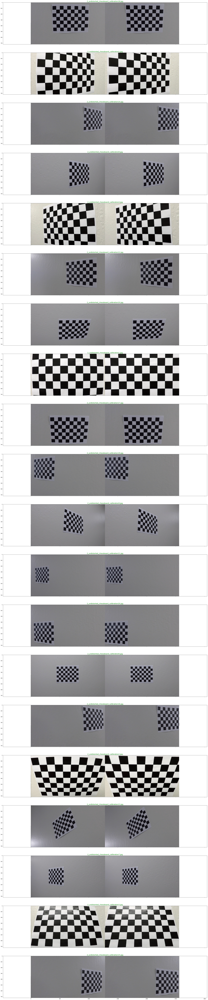

In [6]:
if show:
    N = len(os.listdir('camera_cal'))
    f, axes = plt.subplots(N, 1, squeeze=True, sharex=True, sharey=True, figsize=(40, 10 * N))

undistort = Rectification(distortion_file=calibration_cache_file, show=show, save=save)
for i, calib_file in enumerate(glob.glob('camera_cal/*.jpg')):
    img = mpimg.imread(calib_file)

    savename = '2_undistorted_chessboard_{}'.format(os.path.split(calib_file)[-1])
    undistorted = undistort.rectify(img, axes=axes[i], filename=savename)

# for i, calib_file in enumerate(glob.glob('camera_cal/*.jpg')):
#     img = mpimg.imread(calib_file)

#     savename = '2_undistorted_chessboard_{}'.format(os.path.split(calib_file)[-1])
#     undistorted = undistort.rectify(img, axes=axes[i], filename=savename)


## Provide an example of a distortion-corrected image.


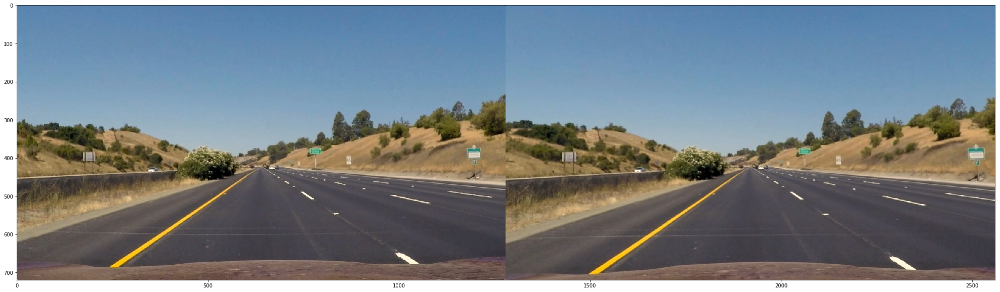

In [7]:
undistort = Rectification(distortion_file=calibration_cache_file, show=True, save=True)
# img = cv2.imread(road_file)
#img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)                
img = mpimg.imread(road_file)
white_balance(img)
undistorted = undistort.rectify(img, filename='2_{}'.format(os.path.split(road_file)[-1]))



# 3. Lane Masking

First - implement this in the original frame


* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.


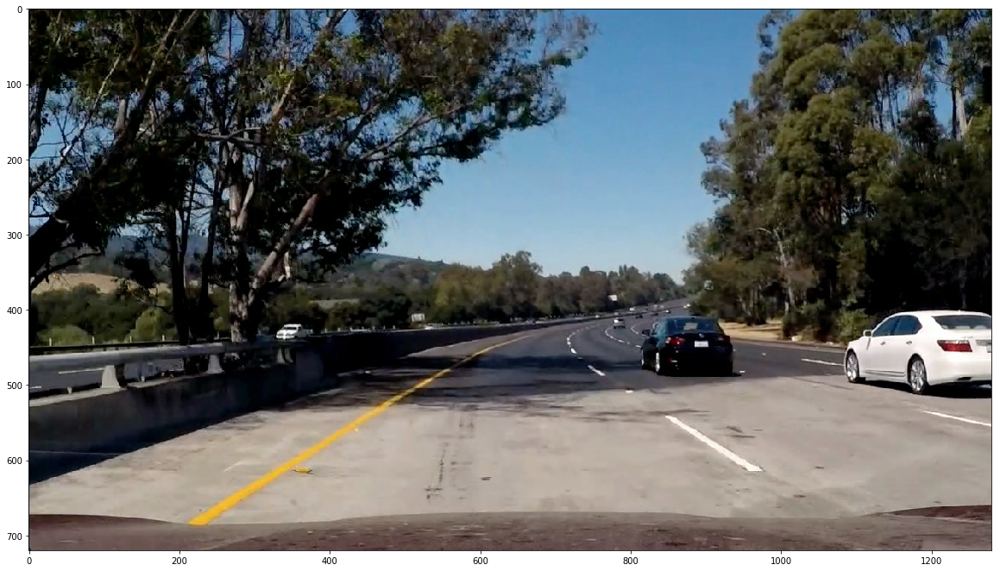

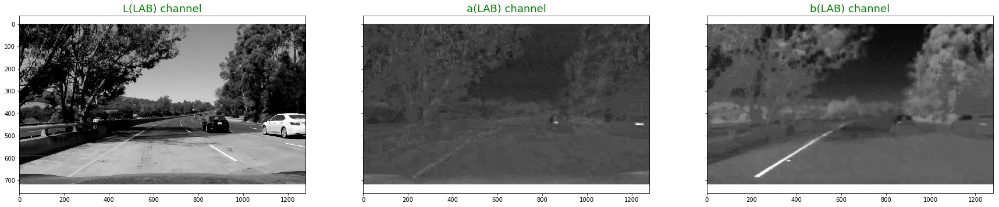

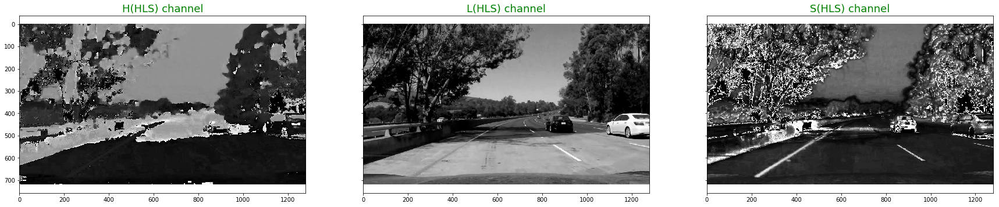

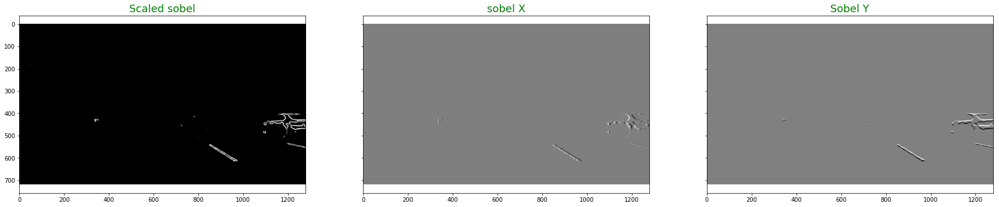

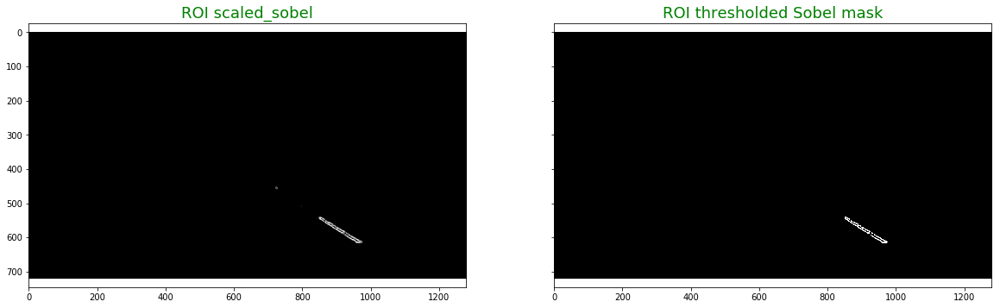

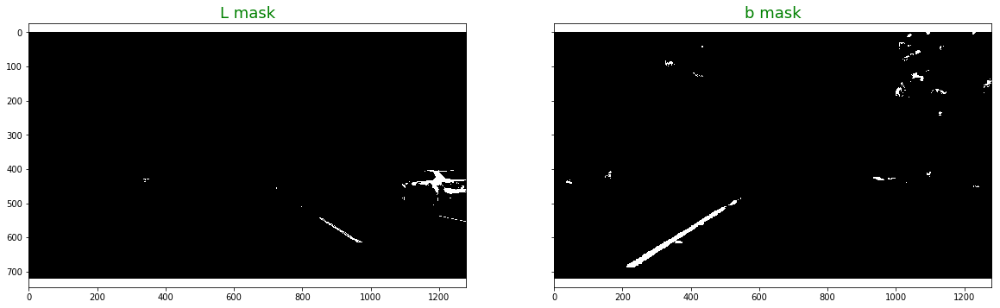

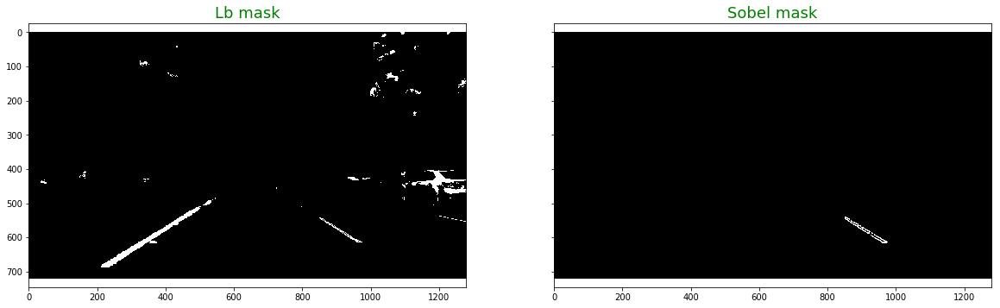

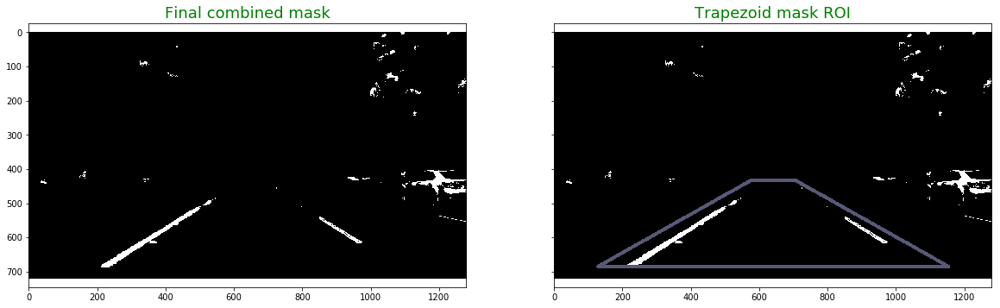

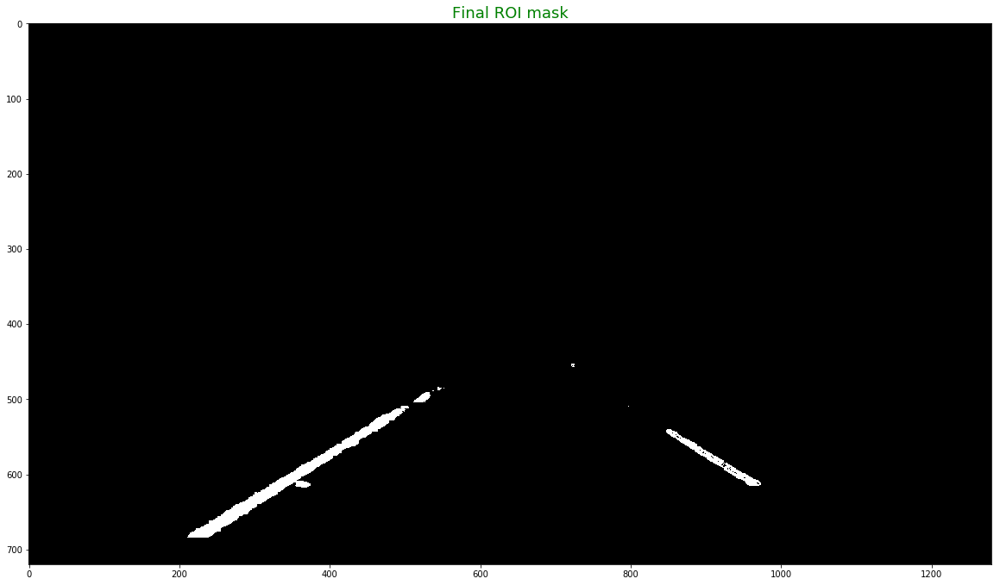

In [8]:
# class Draw(object):
    
#             lines = [[bottom_left + bottom_right], [bottom_right + upper_right], [upper_right + upper_left], [upper_left + bottom_left]]
#             plt.figure(figsize = (10,10))
#             _tmp = Lc.copy()
#             draw_lines(_tmp, lines, color=[100, 0, 0], thickness=10)
    
class MaskPipeline(object):
    
    def __init__(self, trapezoid_params, save=False, show=False, nimage=-1):
        self.save = save
        self.show = show
        self.nimage = nimage
        self.trapezoid_params = trapezoid_params

    @staticmethod
    def _ROI(img, vertices):
        """
        Applies an image mask.

        Only keeps the region of the image defined by the polygon
        formed from `vertices`. The rest of the image is set to black.
        `vertices` should be a numpy array of integer points.
        """
        #defining a blank mask to start with
        mask = np.zeros_like(img)   

        #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
        if len(img.shape) > 2:
            channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
            ignore_mask_color = (255,) * channel_count
        else:
            ignore_mask_color = 255

        #filling pixels inside the polygon defined by "vertices" with the fill color    
        cv2.fillPoly(mask, vertices, ignore_mask_color)

        #returning the image only where mask pixels are nonzero
        masked_image = cv2.bitwise_and(img, mask)
        return masked_image

    def trapezoid(self, img, trapezoid_params=None):
        Y, X = img.shape[:2]
        # calc ROI
        if trapezoid_params is None:
            trapezoid_params = self.trapezoid_params

        x_l = trapezoid_params["x_l"] #0.05 
        x_h = trapezoid_params["x_h"] #0.075
        y_h = trapezoid_params["y_h"] #0.9
        y_l = trapezoid_params["y_l"] #0.6
        #         bottom_left = [int(x_l * X), int(y_h * Y)]
        #         bottom_right = [int((1 - x_l) * X), int(y_h * Y)]
        #         upper_right = [int((0.55 + x_h) * X), int(y_l * Y)]
        #         upper_left = [int((0.55 - x_h) * X), int(y_l * Y)]
        bx = 0 #int(0.05 * X) * 0
        bottom_left = [int(x_l * X + bx), int(y_h * Y)]
        bottom_right = [int((1 - x_l) * X + bx), int(y_h * Y)]
        upper_right = [int((1 - x_h) * X + bx), int(y_l * Y)]
        upper_left = [int(x_h * X + bx), int(y_l * Y)]

        return bottom_left, bottom_right, upper_right, upper_left    
    
    def region_of_interest(self, img, trapezoid_params=None):
#         _t = self.trapezoid_params
#         if not trapezoid_params is None:
#             self.trapezoid_params = trapezoid_params
            
        bottom_left, bottom_right, upper_right, upper_left = self.trapezoid(img, trapezoid_params)
        roi_lines = [np.array([bottom_left, bottom_right, upper_right, upper_left])]
        
#         self.trapezoid_params = _t
        return self._ROI(img, roi_lines)
    
    def Sobel(self, L, sobel_kernel=5, percentile=sobel_anomaly_percentile):
        h, w = img.shape[:2]
        
        L = cv2.GaussianBlur(L, (sobel_kernel, sobel_kernel), 0)
        
        sobel_x = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobel_y = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        sobel = np.sqrt(np.power(sobel_x, 2) + np.power(sobel_y, 2))

        scaled_sobel = np.uint8(255 * sobel / np.max(sobel))
        if self.show:
            n = 10
            m_pics = 3
#             f, axes = plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))
            fig, axes = setup_figure(m_pics, w, h)
                
            axes[0].imshow(scaled_sobel, cmap='gray')
            axes[0].set_title("Scaled sobel", color='g', fontsize=18)            
            axes[1].imshow(sobel_x, cmap='gray')
            axes[1].set_title("sobel X", color='g', fontsize=18)
            axes[2].imshow(sobel_y, cmap='gray')
            axes[2].set_title("Sobel Y", color='g', fontsize=18)
            
        scaled_sobel = self.region_of_interest(scaled_sobel)
        _, sobel_mask = cv2.threshold(scaled_sobel, np.percentile(scaled_sobel.flatten(), percentile), 255, cv2.THRESH_BINARY)
        if self.show:
            
            n = 10
            m_pics = 2
            #f, axes = plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))
            fig, axes = setup_figure(m_pics, w, h)
            
                
            axes[0].imshow(scaled_sobel, cmap='gray')
            axes[0].set_title("ROI scaled_sobel", color='g', fontsize=18)            
            axes[1].imshow(sobel_mask, cmap='gray')
            axes[1].set_title("ROI thresholded Sobel mask", color='g', fontsize=18)            

        return sobel_mask

    def intensity_mask(self, gray, percentile=95):
        _, mask = cv2.threshold(gray, np.percentile(gray.flatten(), percentile), 255, cv2.THRESH_BINARY)
        return mask #cv2.bitwise_and(gray, gray, mask=mask)

    def show_masks(self, h, w, l_mask, b_mask, Lb_mask, sobel_mask, combined_mask, roi_mask, img_file):

        if self.save and img_file:
            cv2.imwrite("{}/{}_Lb_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), Lb_mask)
            cv2.imwrite("{}/{}_roi_sobel_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), sobel_mask)
            cv2.imwrite("{}/{}_roi_combined_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), roi_mask)

        if  self.show:

            fig, axes = setup_figure(2, w, h)
            axes[0].imshow(l_mask, cmap='gray')
            axes[0].set_title("L mask", color='g', fontsize=18)

            axes[1].imshow(b_mask, cmap='gray')
            axes[1].set_title("b mask", color='g', fontsize=18)

            fig, axes = setup_figure(2, w, h)

            axes[0].imshow(Lb_mask, cmap='gray')
            axes[0].set_title("Lb mask", color='g', fontsize=18)
            axes[1].imshow(sobel_mask, cmap='gray')
            axes[1].set_title("Sobel mask", color='g', fontsize=18)

            bottom_left, bottom_right, upper_right, upper_left = self.trapezoid(img)
            lines = [[bottom_left + bottom_right], [bottom_right + upper_right], \
                     [upper_right + upper_left], [upper_left + bottom_left]]

            _tmp = combined_mask.copy()
            draw_lines(_tmp, lines, color=[100, 0, 0], thickness=10)

            fig, axes = setup_figure(2, w, h)
            axes[0].imshow(combined_mask, cmap='gray')
            axes[0].set_title("Final combined mask", color='g', fontsize=18)

            axes[1].imshow(_tmp, cmap='bone')
            axes[1].set_title("Trapezoid mask ROI", color='g', fontsize=18)

            plt.figure(figsize=(20, 20))

            plt.imshow(roi_mask, cmap='gray')
            plt.title("Final ROI mask", color='g', fontsize=18)

    @staticmethod
    def skeletize(img):
        """ """
        size = np.size(img)
        skel = np.zeros(img.shape, np.uint8)
        element = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
        done = False

        while( not done):
            eroded = cv2.erode(img, element)
            temp = cv2.dilate(eroded, element)
            temp = cv2.subtract(img, temp)
            skel = cv2.bitwise_or(skel, temp)
            img = eroded.copy()

            zeros = size - cv2.countNonZero(img)
            if zeros==size:
                done = True

        # close little holes
        skel = cv2.morphologyEx(skel, cv2.MORPH_CLOSE, kernel=np.ones((5,5),np.uint8))
        return skel

#     def process(self, img_file=None, img=None, sobel_kernel=7, sobel_anomaly_th=sobel_anomaly_percentile, 
#                 l_intensity_anomaly_th=l_intensity_anomaly_percentile, b_intensity_anomaly_th=b_intensity_anomaly_percentile):
    def process(self, img_file=None, img=None, sobel_kernel=7, sobel_anomaly_th=None, l_intensity_anomaly_th=None, b_intensity_anomaly_th=None):
        if sobel_anomaly_th is None:
            raise Exception("No sobel th")
        elif l_intensity_anomaly_th is None:
            raise Exception("No L th")
        elif b_intensity_anomaly_th is None:
            raise Exception("No b th")

        if img is None:
            img = mpimg.imread(img_file)
        
        white_balance(img)
        # perceptually uniform CIELab colorspace 
        h, w = img.shape[:2]
        if self.show:
            plt.figure(figsize=(20, 20))
            plt.imshow(img)
        
        lab_image = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
        channels_names = ("L(LAB) channel", "a(LAB) channel", "b(LAB) channel")
        if self.show:
            fig, axes = setup_figure(3, w, h)
            for i in range(3):
                axes[i].imshow(lab_image[:,:,i], cmap='gray')
                axes[i].set_title(channels_names[i], color='g', fontsize=18)

                
        hls_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        channels_names = ("H(HLS) channel", "L(HLS) channel", "S(HLS) channel")
        if self.show:
            fig, axes = setup_figure(3, w, h)
            for i in range(3):
                axes[i].imshow(hls_image[:,:,i], cmap='gray')
                axes[i].set_title(channels_names[i], color='g', fontsize=18)
                
        # like [::,i], but more elegant
        # l - lightness
        # a - greed/red
        # b - yellow/blue
        (lab_l_channel, lab_a_channel, lab_b_channel) = cv2.split(lab_image)
        (hls_h_channel, hls_l_channel, hls_s_channel) = cv2.split(hls_image)
        if self.save:
            stacked = np.concatenate((lab_l_channel, lab_a_channel, lab_b_channel), axis=1)
            cv2.imwrite("{}/{}_LAB_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), stacked)

        #sobel_mask_l = self.Sobel(l_channel, percentile=sobel_anomaly_th)
        #         sobel_mask_b = self.Sobel(b_channel, percentile=sobel_anomaly_th)
        #         sobel_mask = cv2.bitwise_or(np.uint8(sobel_mask_l), np.uint8(sobel_mask_b))
        #         sobel_mask = self.Sobel(l_channel, percentile=sobel_anomaly_th)
        #l_channel[:int(0.2 * l_channel.shape[0]), :] = 0
        lab_l_mask = self.intensity_mask(lab_l_channel, percentile=l_intensity_anomaly_th)
        #hls_l_mask = self.intensity_mask(hls_l_channel, percentile=l_intensity_anomaly_th)
        b_mask = self.intensity_mask(lab_b_channel, percentile=b_intensity_anomaly_th)

        Lb_mask = cv2.bitwise_or(lab_l_mask, b_mask)
        
        Lb_mask = Lb_mask/Lb_mask.max()
        

        sobel_mask = self.Sobel(lab_l_mask, percentile=sobel_anomaly_th)
        sobel_mask = sobel_mask / sobel_mask.max()

        #mask = cv2.bitwise_or(np.uint8(Lb_mask), np.uint8(sobel_mask))
        #         combined_mask = cv2.bitwise_or(np.uint8(Lb_mask), np.uint8(sobel_mask))
        combined_mask = cv2.bitwise_or(Lb_mask, sobel_mask) * 255
        
        roi_mask = self.region_of_interest(combined_mask)
        #roi_mask = self.skeletize(roi_mask)
        #roi_mask = cv2.erode(roi_mask, kernel=np.ones((5,5),np.uint8), iterations=1)
        #roi_mask = cv2.morphologyEx(roi_mask, cv2.MORPH_CLOSE, kernel=np.ones((int(0.02 * img.shape[1]),1),np.uint8))
        #roi_mask = cv2.morphologyEx(roi_mask, cv2.MORPH_CLOSE, kernel=np.ones((5,1),np.uint8))
        self.show_masks(h, w, lab_l_mask, b_mask, Lb_mask, sobel_mask, combined_mask, roi_mask, img_file)

        return roi_mask

mask_pipeline = MaskPipeline(show=show, save=save, trapezoid_params=trapezoid_params, nimage=3)

# roi_mask = mask_pipeline.process(img_file=road_file)  #road_file = glob.glob('test_images/*.jpg')[4]
# img_file = glob.glob('test_images/*.jpg')[-1]
img_file=glob.glob('test_images/*.jpg')[4]
#vid = 'project_video.mp4'
# vid = 'challenge_video.mp4'
# nframe=172
# nframe=608
# nframe = 1014
# nframe = 0
# video = VideoFileClip(vid)
# img = video.get_frame(nframe*1.0/video.fps)


# roi_mask = mask_pipeline.process(img_file, b_intensity_anomaly_th=90, l_intensity_anomaly_th=99)
roi_mask = mask_pipeline.process(img_file, sobel_anomaly_th=sobel_anomaly_percentile, l_intensity_anomaly_th=l_intensity_anomaly_percentile, b_intensity_anomaly_th=b_intensity_anomaly_percentile)







# 4. Perspective transform

* Apply a perspective transform to rectify binary image ("birds-eye view").


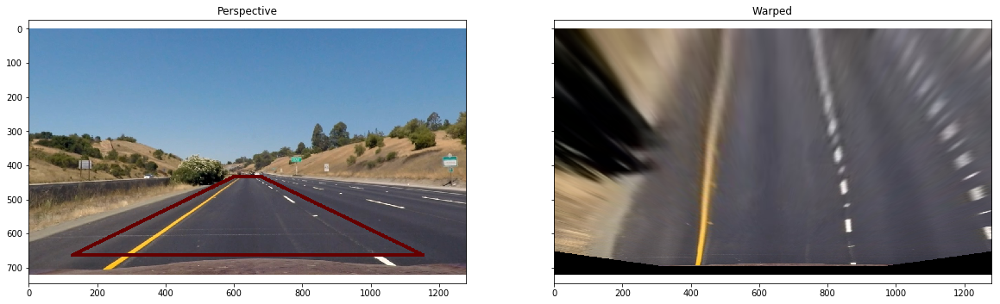

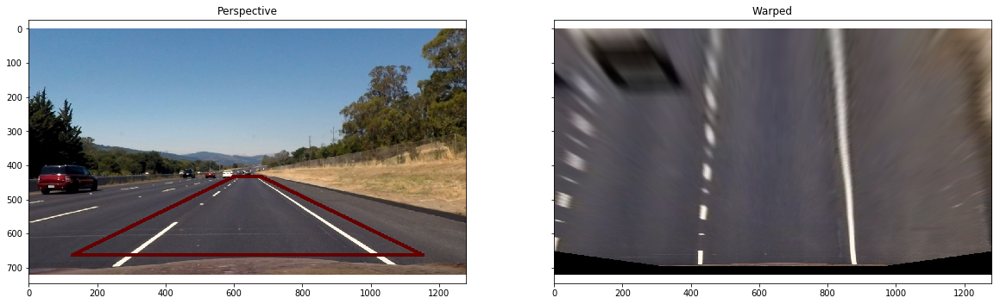

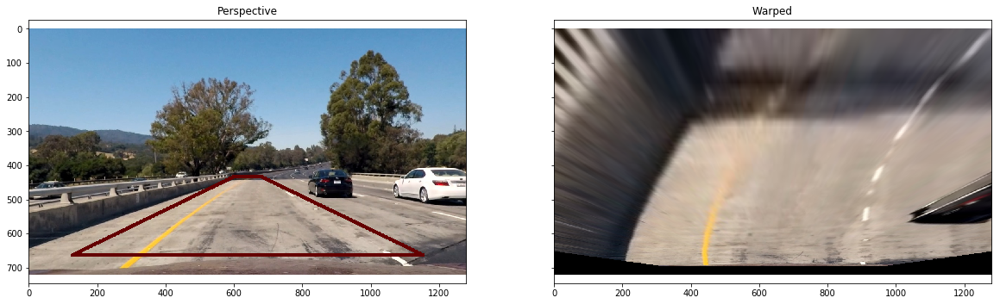

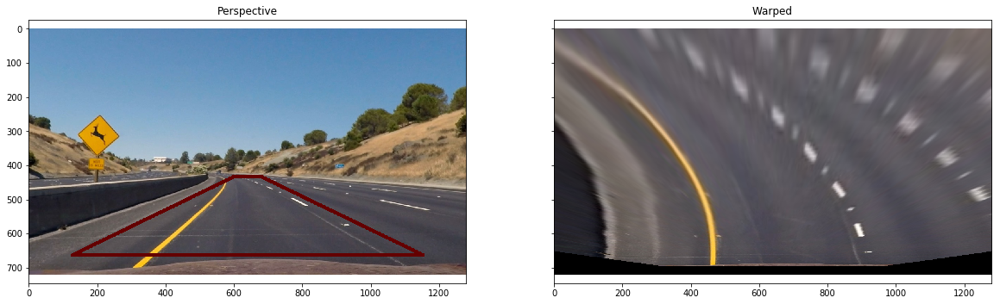

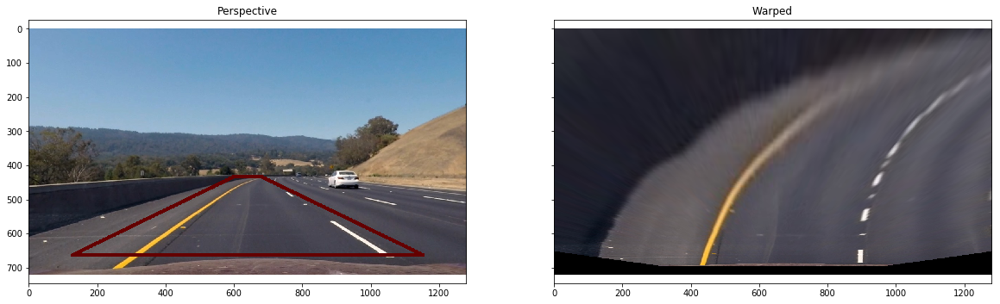

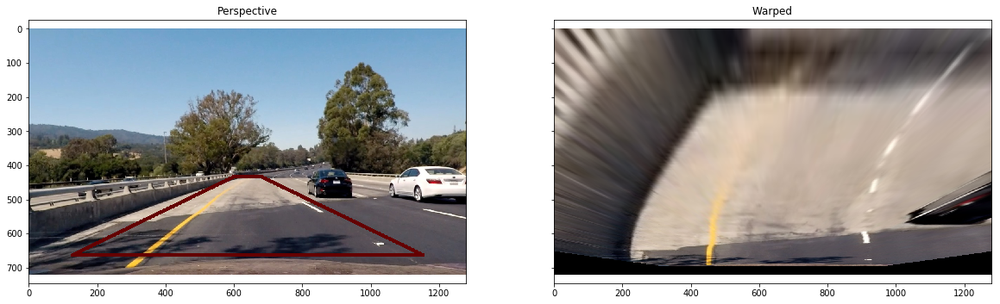

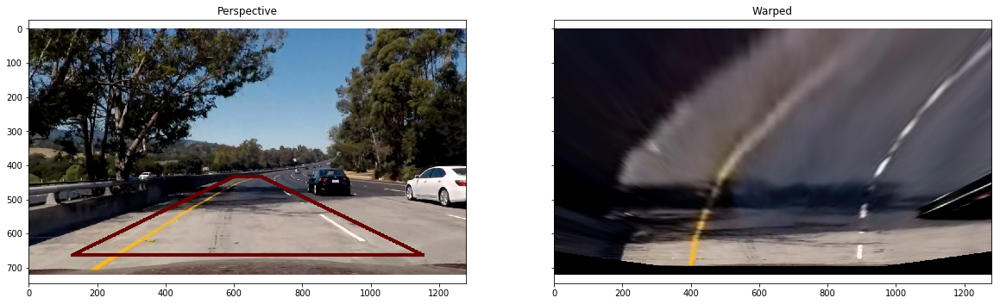

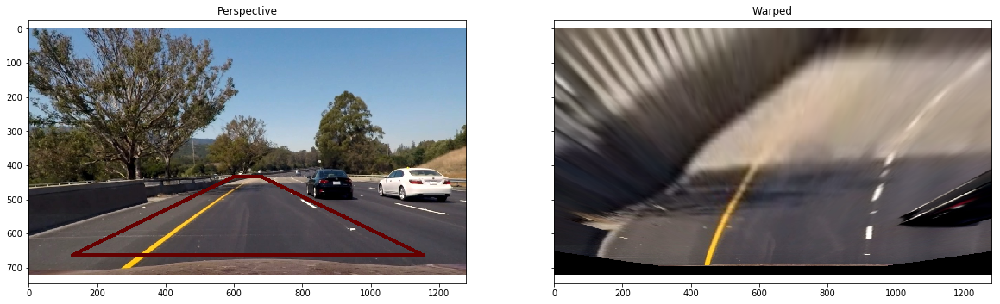

In [9]:
undistort = Rectification(distortion_file=calibration_cache_file, show=False, save=False)

img = mpimg.imread(road_file)
Y, X = img.shape[:2]


class BirdEye(object):

    def __init__(self, shape, save=False, show=False, car_hood=0.08, road_height=0.4):
        #         assert isinstance(shape, tuple)
        #         assert len(shape) == 2
        self._car_hood = car_hood
        self._road_height = road_height

        self.shape = shape
        upper_left = (0.1, 1 - self._car_hood)
        upper_right = (0.9, 1 - self._car_hood)
        mid_right = (0.53, 1 - self._road_height)
        mid_left = (0.47, 1 - self._road_height)     
        self.set_anchors(upper_left, upper_right, mid_left, mid_right)
        self.calc_transform()

    def set_anchors(self, upper_left, upper_right, mid_left, mid_right):

        self.upper_left = [int(upper_left[0] * X), int(upper_left[1] * Y)]
        self.upper_right = [int(upper_right[0] * X), int(upper_right[1] * Y)]
        self.mid_right = [int(mid_right[0] * X), int(mid_right[1] * Y)]
        self.mid_left = [int(mid_left[0] * X), int(mid_left[1] * Y)]
        self.source_points = [self.upper_left, self.mid_left, self.mid_right, self.upper_right]
    
    def calc_transform(self):
        #         self.upper_left = [int(0.1 * X), int((1 - self.car_hood_) * Y)]
        #         self.upper_right = [int(0.9 * X), int((1 - self.car_hood_) * Y)]
        #         self.mid_right = [int((0.53) * X), int((1 - self.road_height_) * Y)]
        #         self.mid_left = [int(0.47 * X), int((1 - self.road_height_) * Y)]        

        #         self.mid_right = [int((0.54) * X), int(0.65 * Y)]
        #         self.mid_left = [int(0.48 * X), int(0.65 * Y)]        

        x0 = 0.25 * X
        x1 = X - x0
        self.warped_points = [(x0, 0.95 * Y), (x0, 0), (x1, 0), (x1 , 0.95 * Y)]
        self.transform_matrix = cv2.getPerspectiveTransform(np.float32(self.source_points), np.float32(self.warped_points))
        
        self.inv_transform_matrix = cv2.getPerspectiveTransform(np.float32(self.warped_points), np.float32(self.source_points))
        
    def transform(self, img):
        unwarped = cv2.warpPerspective(img, self.transform_matrix, self.shape, flags=cv2.INTER_LINEAR)
        return unwarped

    def inv_transform(self, unwarped_img):
        img = cv2.warpPerspective(unwarped_img, self.inv_transform_matrix, self.shape, flags=cv2.INTER_LINEAR)
        return img
    
    def lines(self):
         return [[self.upper_left + self.upper_right], [self.upper_right + self.mid_right], \
                   [self.mid_right + self.mid_left], [self.mid_left + self.upper_left]]

bird_eye = BirdEye(shape=(X, Y))
for i, img_file in enumerate(sorted(glob.glob('test_images/*.jpg'))):

    img = mpimg.imread(img_file)
    img = undistort.rectify(img)
    unwarped = bird_eye.transform(img)
    #     unwarped = cv2.warpPerspective(img, transform_matrix, (X, Y), flags=cv2.INTER_LINEAR)
    
    _tmp = img.copy()
    
    draw_lines(_tmp, bird_eye.lines(), color=[100, 0, 0], thickness=10)
    _, axes = setup_figure(2, X, Y)
    
    axes[0].imshow(_tmp)
    axes[0].set_title("Perspective")
    
    axes[1].imshow(unwarped)
    axes[1].set_title("Warped")
    
    stacked = np.concatenate((_tmp, unwarped), axis=1)
    cv2.imwrite("{}/4_birdeye_view_{}".format(OUT, os.path.split(img_file)[-1]), cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))

# plt.imshow(unwarped)


# 5. Detect lane pixels

## Lane Masking 

* Detect lane pixels and fit to find the lane boundary.
* Reuse MaskPipeline with a trapezoid that is a rectangle

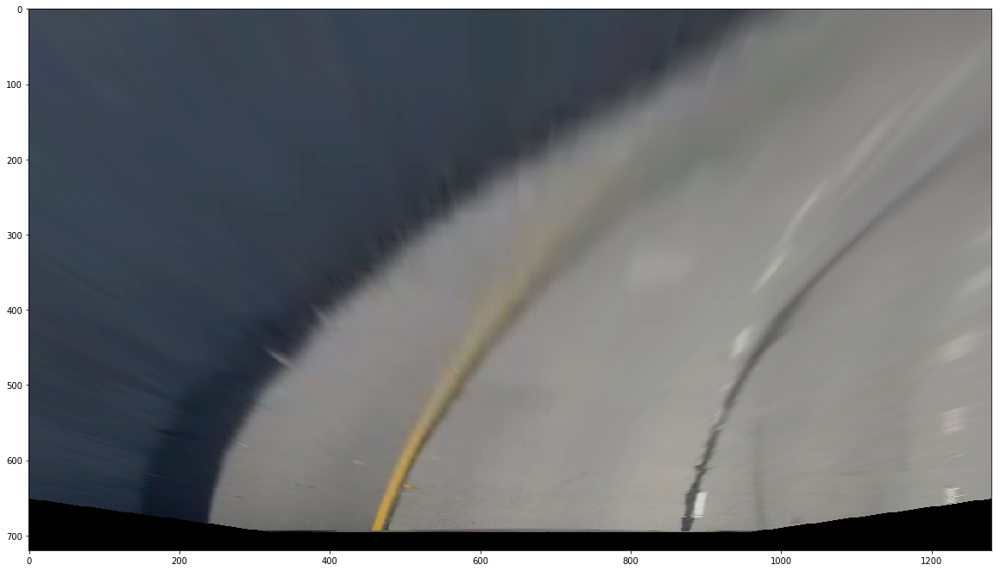

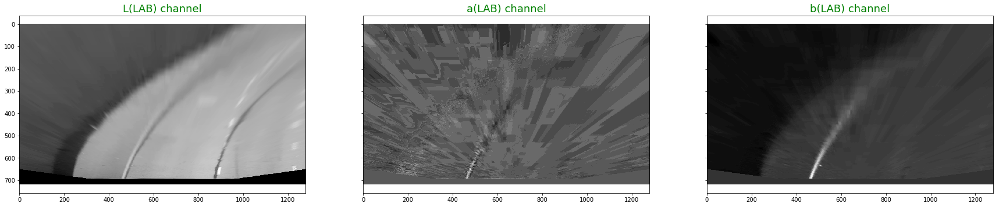

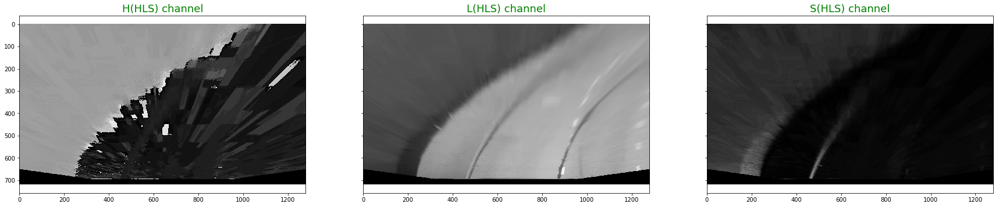

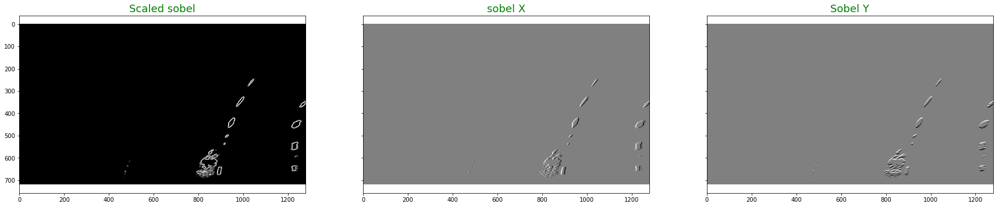

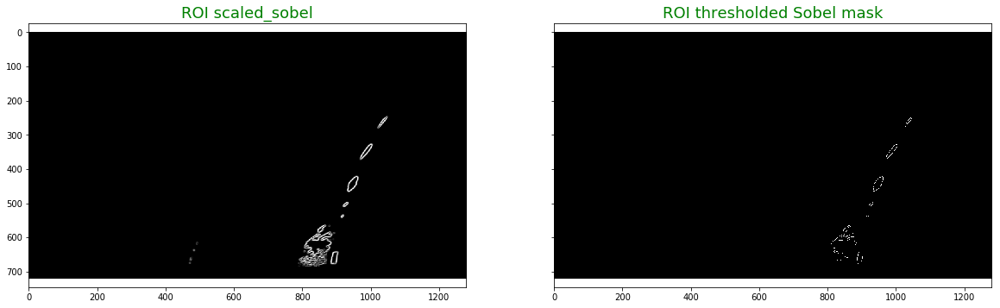

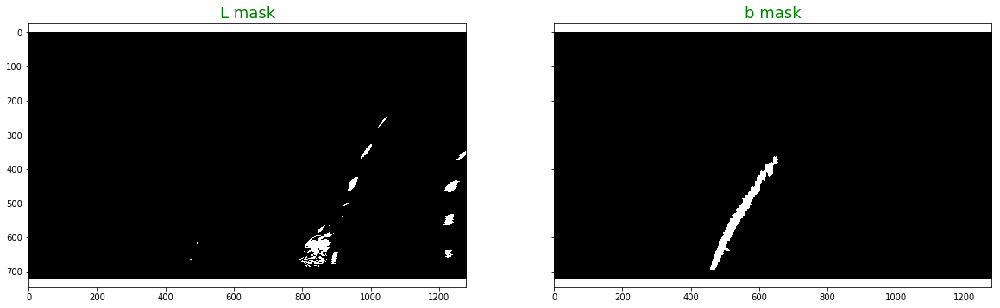

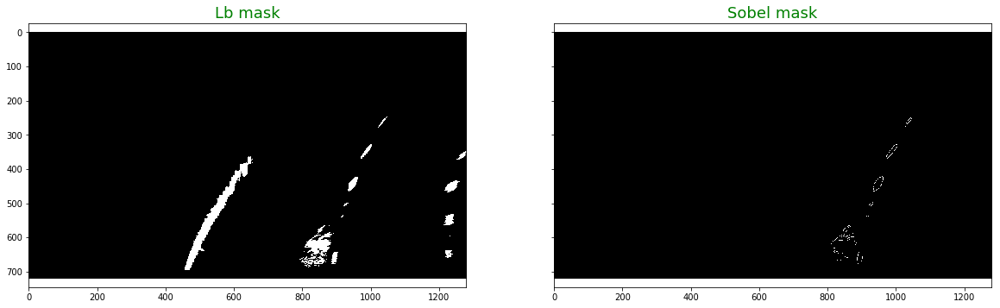

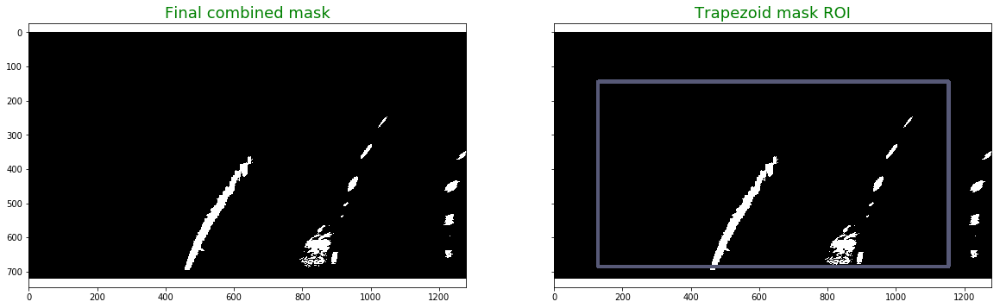

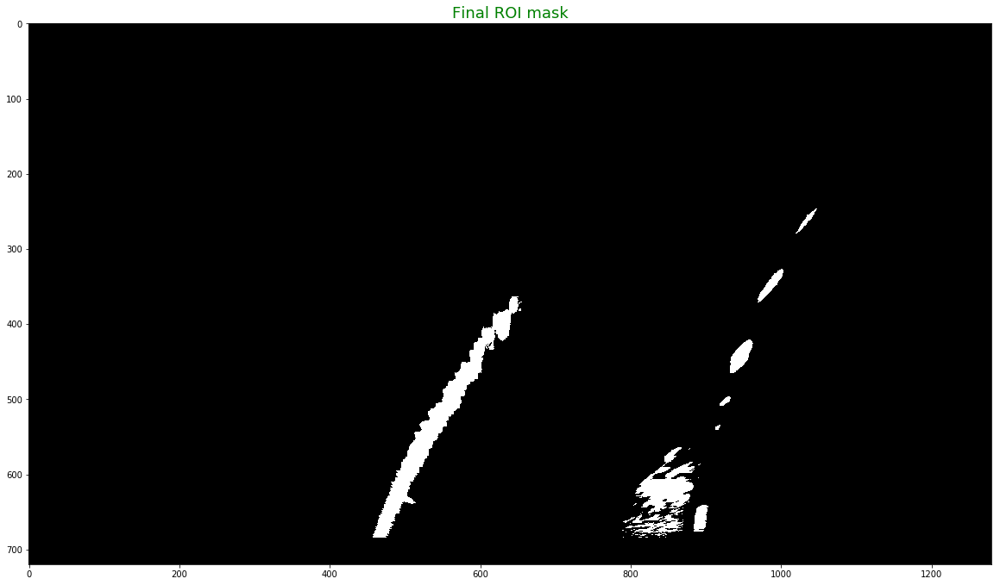

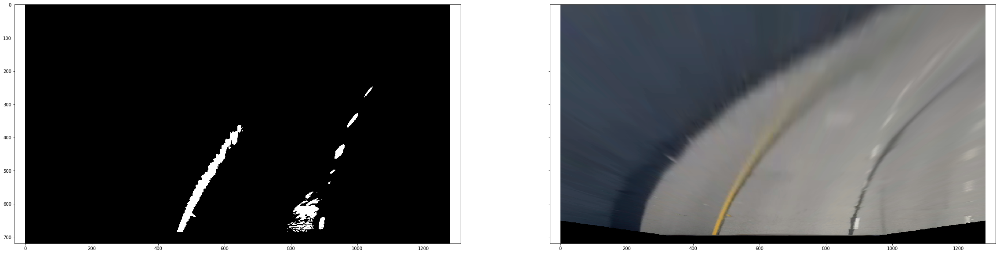

In [39]:
### DEBUG ###
debug = True
if debug:
    
    #     trapezoid_params_ = {"x_l": 0.1, "x_h": 0.45, "y_h":0.95, "y_l": 0.6}
    #     trapezoid_params_flat = {"x_l": 0.1, "x_h": 0.1, "y_h":1.0, "y_l": 0.4}
    #     trapezoid_params = {"x_l": 0.1, "x_h": 0.45, "y_h":0.95, "y_l": 0.6}
    #     trapezoid_params_flat = {"x_l": 0.1, "x_h": 0.1, "y_h":1.0, "y_l": 0.0}

    mask_pipeline = MaskPipeline(show=show, save=False, trapezoid_params=trapezoid_params_flat, nimage=None)
    undistort = Rectification(distortion_file=calibration_cache_file, show=False, save=False)

    vid = 'challenge_video.mp4'
    #     vid = 'project_video.mp4'
    # nframe=172
    # nframe=608
    #     nframe = 1014
    nframe = 0
    video = VideoFileClip(vid)
    img = video.get_frame(nframe*1.0/video.fps)
    bird_eye = BirdEye(shape=(img.shape[1], img.shape[0]), road_height=0.37)
    
    img = undistort.rectify(img)
    img_bird_eye = img = bird_eye.transform(img)
        
    roi_mask = mask_pipeline.process(img=img, img_file=img_file, sobel_anomaly_th=sobel_anomaly_percentile, 
                                     l_intensity_anomaly_th=l_intensity_anomaly_percentile, b_intensity_anomaly_th=b_intensity_anomaly_percentile)
                                     
                                     
                                     #b_intensity_anomaly_th=90, l_intensity_anomaly_th=99)
#     roi_mask = bird_eye.transform(roi_mask)

#     roi_mask = mask_pipeline.region_of_interest(roi_mask, trapezoid_params_flat)

    bottom_left, bottom_right, upper_right, upper_left = mask_pipeline.trapezoid(roi_mask, trapezoid_params_flat)
    lines = [[bottom_left + bottom_right], [bottom_right + upper_right], \
             [upper_right + upper_left], [upper_left + bottom_left]]

    _tmp = roi_mask.copy()
    draw_lines(255 * _tmp, lines, color=[100, 0, 0], thickness=10)
            
    f, axes = plt.subplots(1, 2, squeeze=True, sharex=True, sharey=True, figsize=(40, 10))
    axes[0].imshow(_tmp, cmap='gray')
    axes[1].imshow(img_bird_eye)

    mask_pipeline.show &= False

    

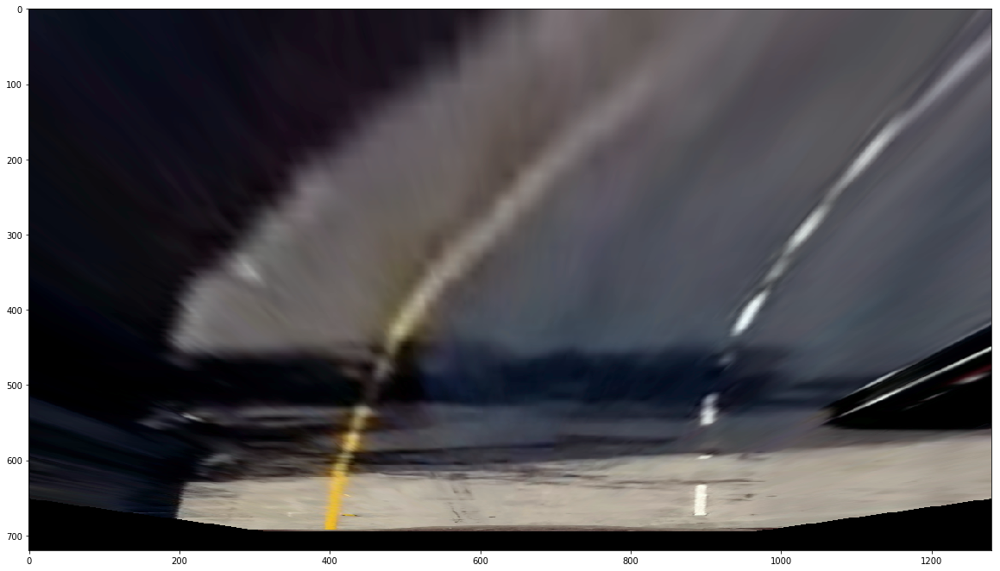

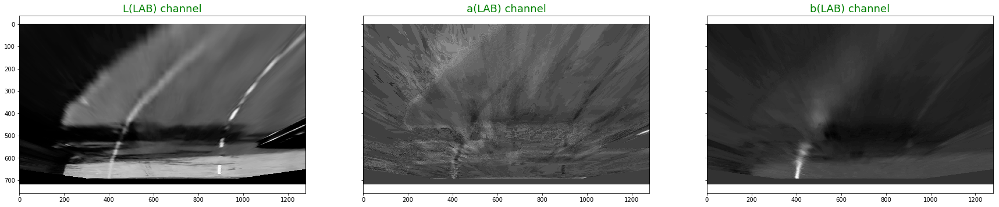

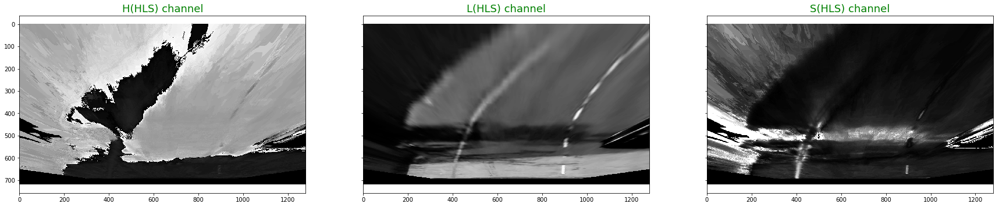

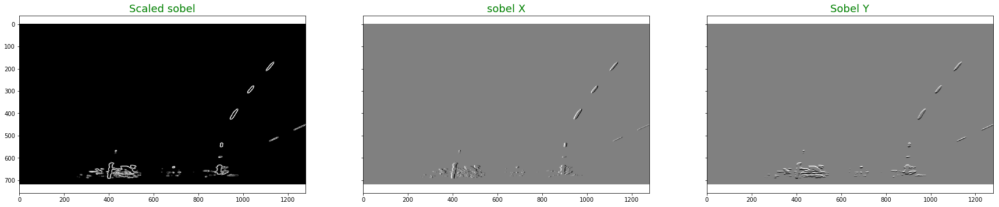

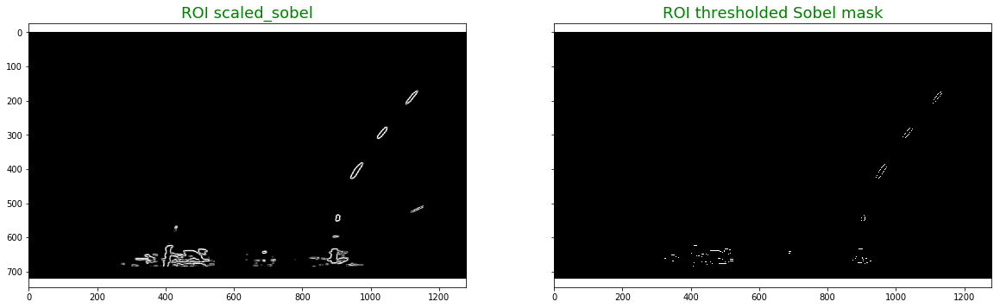

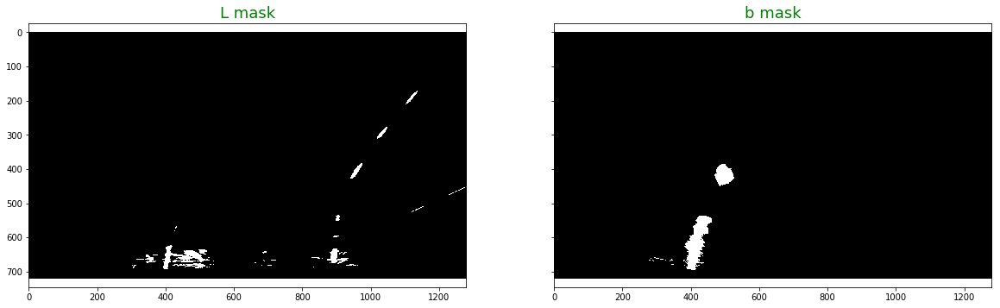

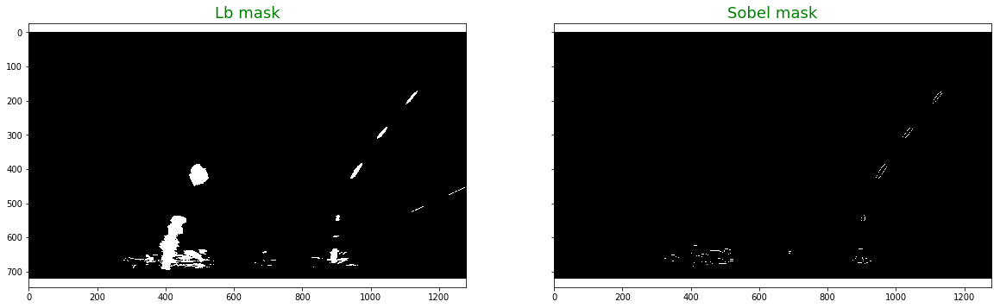

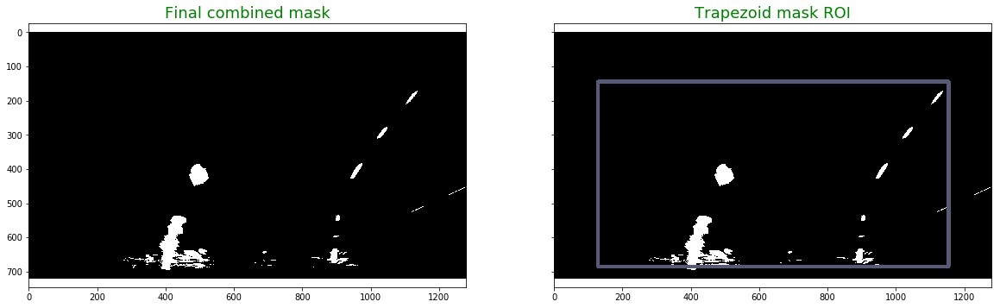

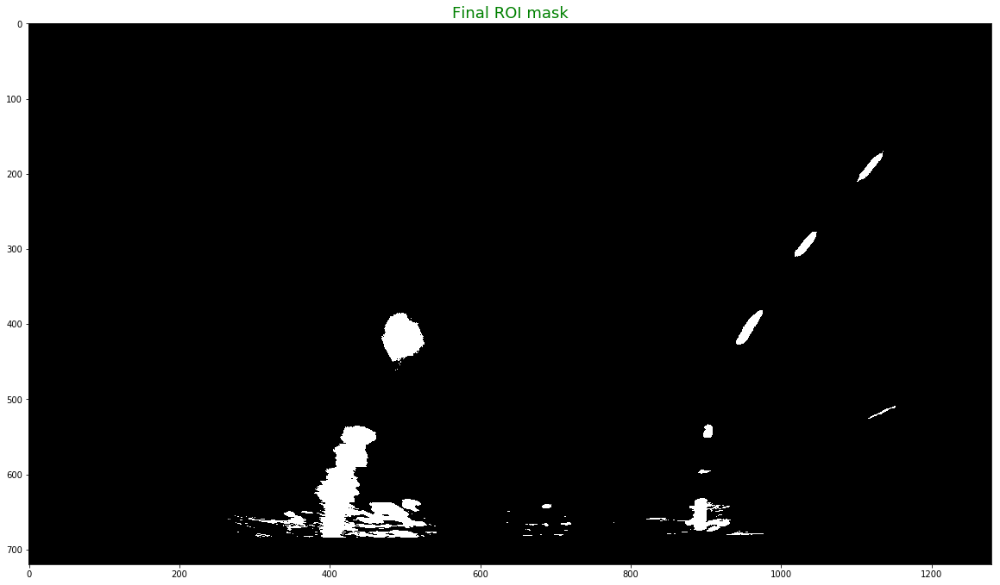

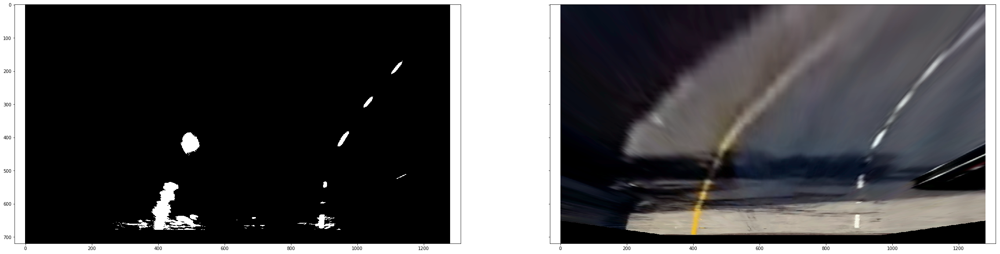

In [41]:
#         bottom_left = [int(x_l * X), int(y_h * Y)]
#         bottom_right = [int((1 - x_l) * X), int(y_h * Y)]
#         upper_right = [int((0.5 + x_h) * X), int(y_l * Y)]
#         upper_left = [int((0.5 - x_h) * X), int(y_l * Y)]

# trapezoid_params_flat = {"x_l": 0.1, "x_h": 0.1, "y_h":0.95, "y_l": 0.0}
# trapezoid_params = {"x_l": 0.1, "x_h": 0.45, "y_h":0.95, "y_l": 0.6}
mask_pipeline = MaskPipeline(show=show, save=save, trapezoid_params=trapezoid_params_flat, nimage=5)

mask_pipeline.show = False
for i, img_file in enumerate(glob.glob('test_images/*.jpg')):
    if i == 4:
        mask_pipeline.show = True
    
    img = mpimg.imread(img_file)
    img = undistort.rectify(img)
    
    bird_eye = BirdEye(shape=(img.shape[1], img.shape[0]))
    img_bird_eye = img = bird_eye.transform(img)
    
    cv2.imwrite("{}/5_rectified_{}".format(OUT, os.path.split(img_file)[-1]), cv2.cvtColor(img_bird_eye, cv2.COLOR_BGR2RGB))
        
    roi_mask = mask_pipeline.process(img=img, img_file=img_file, sobel_anomaly_th=sobel_anomaly_percentile, 
                                     l_intensity_anomaly_th=l_intensity_anomaly_percentile, b_intensity_anomaly_th=b_intensity_anomaly_percentile)
                                     
                                     
                                     #b_intensity_anomaly_th=90, l_intensity_anomaly_th=99)
#     roi_mask = bird_eye.transform(roi_mask)
#     roi_mask = mask_pipeline.region_of_interest(roi_mask, trapezoid_params_flat)

    bottom_left, bottom_right, upper_right, upper_left = mask_pipeline.trapezoid(roi_mask, trapezoid_params_flat)
    lines = [[bottom_left + bottom_right], [bottom_right + upper_right], \
             [upper_right + upper_left], [upper_left + bottom_left]]

    _tmp = roi_mask.copy() * 255
    draw_lines(_tmp, lines, color=[100, 0, 0], thickness=10)
    cv2.imwrite("{}/5_rectified_bw_{}".format(OUT, os.path.split(img_file)[-1]), _tmp)
            
    if mask_pipeline.show:
        f, axes = plt.subplots(1, 2, squeeze=True, sharex=True, sharey=True, figsize=(40, 10))
        axes[0].imshow(_tmp, cmap='gray')
        axes[1].imshow(img_bird_eye)

    mask_pipeline.show &= False

    

## Lane localization

* Determine the curvature of the lane and vehicle position with respect to center.
* Propogate back to the real world
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


The x_hist function taken from the Udacity quiz


### Line class

In [53]:
#def DrawLane(img, line_params):
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self, basex):
        
        # end of line
        self.endx = None
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = None
        
        #polynomial coefficients for the most recent fit
        self.prev_fit = None
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = basex 
        #difference in fit coefficients between last and new fits+
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
        self.margins = []
        self.base_margin = 120
        self.margin = self.base_margin

        # Define conversions in x and y from pixels space to meters
        self.ym_per_pix = 30 / 720 # meters per pixel in y dimension
        self.xm_per_pix = 3.7 / 700 # meters per pixel in x dimension    
        
#         self.regressor = linear_model.RANSACRegressor()
        
    def reset_margin(self):
        self.margin = self.base_margin

    def set_pixels(self, x, y):
        self.allx = x
        self.ally = y
    
    def get_pixels(self):
        return self.allx, self.ally
        
    #     @staticmethod
    def polyfit(self, Y, X, rank=2, robust=False):
        if len(Y) == 0:
            params = self.best_fit
            
        elif not robust:
            
            params = np.polyfit(Y, X, rank)
        else:
            _y = Y.reshape(-1,1)
            _x = X.reshape(-1,1)            
            ransac = RANSACRegressor(random_state=np.random.randint(0, 1000))
            ransac = ransac.fit(PolynomialFeatures(degree=rank).fit_transform(_y), _x)
            inliers = ransac.inlier_mask_
            
            weights = np.sqrt(Y[inliers]) 
            weights = weights/np.max(weights)
            params = np.polyfit(Y[inliers], X[inliers], rank)
        
        return params

    @staticmethod
    def polyval(p, Y):
        return np.polyval(p, Y)
    
    def fit(self):

        self.current_fit = self.polyfit(self.ally, self.allx, 2, robust=True) #np.polyfit(self.ally, self.allx, 2)
        self.current_fit_m = copy.deepcopy(self.current_fit)
        self.line_to_m(self.current_fit_m)
        #self.recent_xfitted.append(self.current_fit)
        
        self.best_fit = self.current_fit
        if len(self.recent_xfitted) > 7:
            
            outliers = False
            for icoef in range(len(self.current_fit)):
                coefs = np.array([coef[icoef] for coef in self.recent_xfitted])
                m = np.mean(coefs)
                s = np.std(coefs)
                if np.abs(coefs - self.current_fit) > 2 * s:
                    outliers = True
                    break

            if outlier:
                return
            
            self.recent_xfitted = self.recent_xfitted[1:] + [self.current_fit]
            self.best_fit = []
            for icoef in range(len(self.current_fit)):
                coefs = np.array([coef[icoef] for coef in self.recent_xfitted])
                m = np.mean(coefs)
                s = np.std(coefs)
                filt = np.abs(coefs - m) < s
                
                weights = np.arange(len(coefs)) / len(coefs)
                coefs = coefs[filt]
                weights = weights[filt]
                self.best_fit.append(np.average(coefs, weights=weights))
        
        # calculate new width of lane to search in
        x_est = self.eval(self.ally)
        d = x_est - self.allx
        self.margin = min(max(20, int(6 * np.std(d))), self.base_margin)
        
    def eval(self, y_arr):
        fitx = np.polyval(self.best_fit, y_arr)  #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        
        try:
            #fitx = np.polyval(self.current_fit, y_arr)  #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#             fitx = np.polyval(self.best_fit, y_arr)  #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            pass
            
        except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            fitx = 1*y_arr**2 + 1*y_arr
        
        return fitx

    def eval_base(self, H):
        
        if self.current_fit is None:
            return self.line_base_pos
        
        self.endx, self.line_base_pos = self.eval([0, H])
        self.endx = int(self.endx)
        self.line_base_pos = int(self.line_base_pos)
        return self.line_base_pos
    
    def eval_physical(self, H):

        #         self.current_fit_m = copy.deepcopy(self.current_fit)
        #         self.line_to_m(self.current_fit_m)
        
        self.radius_of_curvature = self.measure_curvature(self.current_fit_m, H * self.ym_per_pix)
        self.line_base_pos = np.polyval(self.current_fit_m, H * self.ym_per_pix)
        return self.radius_of_curvature, self.line_base_pos
    
        
    def line_to_m(self, line_params):
        # line is a y->x mapping
        # x = a * y**2 + b * x + c
        # a -> a * xm_per_pix / ym_per_pix**2
        # b -> b * xm_per_pix / ym_per_pix
        # c -> c * xm_per_pix
        #self.ym_per_pix = 30 / 720 # meters per pixel in y dimension
        #self.xm_per_pix = 3.7 / 700 # meters per pixel in x dimension

        line_params[0] *= self.xm_per_pix / self.ym_per_pix ** 2
        line_params[1] *= self.xm_per_pix / self.ym_per_pix
        line_params[2] *= self.xm_per_pix
            

    @staticmethod
    def measure_curvature(line_params, y):
        A, B = line_params[0:2]
        curvature = np.power(1+(2*A*y+B)**2, 1.5) / np.abs(2*A)
        return curvature
        


### Localization class

In [54]:
new_method = True
class Localization(object):
#     left_lane = Line()
#     right_lane = Line()

    def __init__(self, save=False, show=False, nimage=-1):
        self.save = save
        self.show = show
        self.nimage = nimage
        self._init_state = True
        
        # hyperparameters
        self.nwindows = 8 # Choose the number of sliding windows
        self.minpix = 25 # Set minimum number of pixels found to recenter window
        # Define conversions in x and y from pixels space to meters
        self.ym_per_pix = 30 / 720 # meters per pixel in y dimension
        self.xm_per_pix = 3.7 / 700 # meters per pixel in x dimension
        
        self.left_lane = None
        self.right_lane = None

        self.base_distances = []
        self.end_distances = []

        self.left_ends = []
        self.right_ends = []
        self.invalid_left = False
        self.invalid_right = False

    @staticmethod
    def x_hist(img, factor=2/3):
        bottom_half = img[int(img.shape[0] * factor):, :]
        histogram = np.sum(bottom_half, axis=0)

        return histogram

    def init(self, img, img_file=''):
        if not self._init_state:
            return

        #         if self.show:
        #             plt.figure(figsize=(20,20))
        #             plt.imshow(img, cmap='gray')
                        

        histogram = self.x_hist(img)
        L = len(histogram)
        dx = np.linspace(0, L, L-1)
        #sigma_pix = int(img.shape[1] * 0.1)
        sigma_pix = max(3, img.shape[1] * 0.01)
        #gx = np.arange(-3*sigma_pix, 3*sigma_pix, dx)
        gaussian = np.exp(-np.power((dx - np.mean(dx))/sigma_pix, 2) / 2.)
        gaussian = gaussian / np.linalg.norm(gaussian)
        histogram = np.convolve(histogram, gaussian, mode="same")        
        
        midpoint = np.int(0.5 * histogram.shape[0])
        if False:
            M = np.power(histogram[:midpoint], 2)
            leftx_peak = int(np.sum(np.linspace(0, len(M)-1, len(M)) * M ) / np.sum(M))

            M = np.power(histogram[midpoint:], 2)
            rightx_peak = int(np.sum(np.linspace(0, len(M)-1, len(M)) * M ) / np.sum(M)) + midpoint
            
            leftx_base = np.argmax(histogram[:midpoint])
            rightx_base = np.argmax(histogram[midpoint:]) + midpoint
            
        else:
            leftx_base = np.argmax(histogram[:midpoint])
            rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        
        if self.show:
            plt.figure(figsize=(20, 5))
            plt.plot(leftx_base, histogram[leftx_base], marker='x', markeredgewidth=10, markersize=10, label='left base')
            plt.plot(rightx_base, histogram[rightx_base], marker='x', markeredgewidth=10, markersize=10, label='left base')
            plt.plot(histogram)
            plt.legend()
            
        if self.save and img_file:
            plt.savefig("{}/{}_histogram_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]))
        
#         self.leftx_base = leftx_base
#         self.rightx_base = rightx_base
        self.left_lane = Line(leftx_base)
        self.right_lane = Line(rightx_base)

#         return leftx_base, rightx_base

    def find_lane_pixels(self, img, img_file):
        
        img = np.uint8(img)
        out_img = []
        if self.show or self.save:
            # Create an output image to draw on and visualize the result
            out_img = np.dstack((img, img, img))
        H = int(1 * img.shape[0])

        # HYPERPARAMETERS
        # Choose the number of sliding windows
        nwindows = 9

        # Set the width of the windows +/- margin
        #         self.left_lane.reset_margin()
        #         self.right_lane.reset_margin()
        
        #margin = 100
        # Set minimum number of pixels found to recenter window
#         minpix = 50

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(H//nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = img.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        left_basex = leftx_current = self.left_lane.eval_base(H) #basex
        right_basex = rightx_current = self.right_lane.eval_base(H) #.basex

        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for iwin, window in enumerate(range(nwindows -1)):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = H - (window+1) * window_height
            win_y_high = H - window * window_height

            left_margin, right_margin = self.left_lane.margin, self.right_lane.margin
            if iwin == 0:
                left_margin, right_margin = self.left_lane.base_margin, self.right_lane.base_margin

            win_xleft_low = leftx_current - left_margin
            win_xleft_high = leftx_current + left_margin
            win_xright_low = rightx_current - right_margin
            win_xright_high = rightx_current + right_margin
            
            ### Identify the nonzero pixels in x and y within the window ###
            good_left_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
            good_left_inds &= (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)
            good_left_inds = good_left_inds.nonzero()[0]
            if len(good_left_inds) == 0:
                self.left_lane.reset_margin()
                left_margin = self.left_lane.margin
                win_xleft_low = leftx_current - left_margin
                win_xleft_high = leftx_current + left_margin
                good_left_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
                good_left_inds &= (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)
                good_left_inds = good_left_inds.nonzero()[0]

            good_right_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
            good_right_inds &= (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)
            good_right_inds = good_right_inds.nonzero()[0]
            if len(good_right_inds) == 0:
                self.right_lane.reset_margin()
                right_margin = self.right_lane.margin
                win_xright_low = rightx_current - right_margin
                win_xright_high = rightx_current + right_margin
                good_right_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
                good_right_inds &= (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)
                good_right_inds = good_right_inds.nonzero()[0]


            # Draw the windows on the visualization image
            if self.show or self.save:
                cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 2) 
                cv2.rectangle(out_img,(win_xright_low,win_y_low), (win_xright_high,win_y_high),(0,255,0), 2) 
            
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)

            ### If you found > minpix pixels, recenter next window ###
            ### (`right` or `leftx_current`) on their mean position ###
            #             if len(good_left_inds) > self.minpix:
            #                 if self.left_lane.current_fit is None:
            #                     pts = nonzerox[good_left_inds]
            #                     avg = np.mean(pts)
            #                     std = np.std(pts)
            #                     pts = pts[np.abs(pts - avg) < 2 * std]
            #                     leftx_current = int(np.mean(pts))
            #                 else:
            #                     leftx_current = int(self.left_lane.eval([win_y_low]))


            if not self.left_lane.current_fit is None:
                Y = H - (window + 1.5) * window_height
                leftx_current = int(self.left_lane.eval([Y]))
                    
            elif len(good_left_inds) > self.minpix:

                Y = H - (window + 1.5) * window_height
                # estimator #1 - average over pixels
                pts = nonzerox[good_left_inds]
                avg = np.mean(pts)
                std = np.std(pts)
                pts = pts[np.abs(pts - avg) < 2 * std]
                leftx_avg = np.mean(pts)

                if not self.left_lane.current_fit is None:
                    leftx_current = self.left_lane.eval([Y])  #rightx_current = int(np.mean([prev_lane_predict, rightx_current]))
                
                elif iwin > 2:
                    # estimator #2 - extrapolate current fit over pixels
                    ridx = np.concatenate(left_lane_inds)

                    leftx = nonzerox[ridx]
                    lefty = nonzeroy[ridx]
                    try:
                        fit =  np.polyfit(lefty, leftx, rank=1)  # Line.polyfit(lefty, leftx, rank=1, robust=False)
                        curr_fit_predict = np.polyval(fit, Y) # Line.polyval(fit, Y)
                        leftx_current = int(0.7 * curr_fit_predict + 0.3 * leftx_avg)
                    except:
                        leftx_current = int(leftx_avg)

            else:
                pass#print(iwin, "not enough pixels!!")
                    

            if not self.right_lane.current_fit is None:
                Y = H - (window + 1.5) * window_height
                rightx_current = int(self.right_lane.eval([Y]))
                    
            elif len(good_right_inds) > self.minpix:

                Y = H - (window + 1.5) * window_height
                # estimator #1 - average over pixels
                pts = nonzerox[good_right_inds]            #                     rightx_current = int(np.mean(nonzerox[good_right_inds]))
                avg = np.mean(pts)
                std = np.std(pts)
                pts = pts[np.abs(pts - avg) < 2 * std]
                rightx_avg = np.mean(pts)

                if not self.right_lane.current_fit is None:
                    rightx_current = self.right_lane.eval([Y])  #rightx_current = int(np.mean([prev_lane_predict, rightx_current]))
                
                elif iwin > 2:
                    # estimator #2 - extrapolate current fit over pixels
                    ridx = np.concatenate(right_lane_inds)

                    rightx = nonzerox[ridx] #np.concatenate([nonzerox[ridx], [right_basex]])
                    righty = nonzeroy[ridx] #np.concatenate([nonzeroy[ridx], [H-1]])
                    try:
                        fit = np.polyfit(righty, rightx, rank=1) #Line.polyfit(righty, rightx, rank=1, robust=False)
                        curr_fit_predict = np.polyval(fit, Y) #Line.polyval(fit, Y)
                        rightx_current = int(0.7 * curr_fit_predict + 0.3 * rightx_avg)
                    except:
                        rightx_current = int(rightx_avg)

            else:
                pass#print(iwin, "not enough pixels!!")


#                     rightx_current = self.right_lane.eval(win_y_high)
            
        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        
        # limit line height to 80% of Height 
        
        self.left_lane.set_pixels(x=leftx, y=lefty)
        self.right_lane.set_pixels(x=rightx, y=righty)
        
        if new_method:
            return out_img
        else:
            return leftx, lefty, rightx, righty, out_img

    def eval(self, img, img_file):
        out_img = self.find_lane_pixels(img, img_file)
        
        ### Fit a second order polynomial to each using `np.polyfit` ###
        self.right_lane.fit()
        self.left_lane.fit()

        # Generate x and y values for plotting
        ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
        left_fitx = self.left_lane.eval(y_arr=ploty)
        right_fitx = self.right_lane.eval(y_arr=ploty)
        
        self.left_lane.eval_base(img.shape[0])
        self.right_lane.eval_base(img.shape[0])
        return out_img, left_fitx, right_fitx

    def fit_polynomial(self, img, img_file):
        
        
#         # Find our lane pixels first
#         #         prev_left_lane = copy.deepcopy(self.left_lane)
#         #         prev_right_lane = copy.deepcopy(self.right_lane)
#         out_img = self.find_lane_pixels(img, img_file)
        
#         ### Fit a second order polynomial to each using `np.polyfit` ###
#         self.right_lane.fit()
#         self.left_lane.fit()

#         # Generate x and y values for plotting
#         ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
#         left_fitx = self.left_lane.eval(y_arr=ploty)
#         right_fitx = self.right_lane.eval(y_arr=ploty)
#         self.left_lane.eval_base(img.shape[0])
#         self.right_lane.eval_base(img.shape[0])
        out_img, left_fitx, right_fity = self.eval(img, img_file)
        # check validity
        #         invalid_left = False
        #             invalid_right = False      
        if len(self.left_ends) > 10:
            restart = False
            if not (np.abs(np.mean(self.left_ends) - self.left_lane.endx) < 2 * np.std(self.left_ends)):
                restart = True #              r   self.left_lane = prev_left_lane
            else:
                self.left_ends = self.left_ends[1:] + [self.left_lane.endx]

            if not (np.abs(np.mean(self.right_ends) - self.right_lane.endx) < 2 * np.std(self.right_ends)):
                restart = True #                 self.right_lane = prev_right_lane
            else:
                self.right_ends = self.right_ends[1:] + [self.right_lane.endx]

            if restart:
                self._init_state = True
                self.init(img)
                out_img, left_fitx, right_fity = self.eval(img, img_file)
                
        else:
            self.left_ends.append(self.left_lane.endx)
            self.right_ends.append(self.right_lane.endx)
        
        
        self._init_state = False
        ## Visualization ##
        # Colors in the left and right lane regions
        if self.show or self.save:
            leftx, lefty = self.left_lane.get_pixels()
            out_img[lefty, leftx] = [255, 0, 0]

            rightx, righty = self.right_lane.get_pixels()
            out_img[righty, rightx] = [0, 0, 255]
                
        return out_img

    def localize(self, img, img_file):

        self.init(img, img_file)
        out_img = self.fit_polynomial(img, img_file)
        
        right_curvature, right_intersection_m = self.right_lane.eval_physical(img.shape[0])
        
        left_curvature, left_intersection_m = self.left_lane.eval_physical(img.shape[0])
        
        curvature = (left_curvature + right_curvature) / 2
        
        # car offset from center of image
        offset = img.shape[1] * self.xm_per_pix / 2 - np.mean([right_intersection_m, left_intersection_m])

        # Plots the left and right polynomials on the lane lines
        if self.show or self.save:
            font = cv2.FONT_HERSHEY_SIMPLEX
            curv_text = "Curvature={:.2f} [m]".format(curvature)
            textsize = cv2.getTextSize(curv_text, font, 1, 2)[0]
            textX = int((out_img.shape[1] * 0.3 - textsize[0]) / 2)
            textY = int(out_img.shape[0] * 0.2 - textsize[1])
            cv2.putText(out_img, curv_text, (textX, textY ), font, 1, (255, 255, 255), 2)

            offset_text = "Offset={:.2f} [m]".format(offset)
            textsize = cv2.getTextSize(offset_text, font, 1, 2)[0]
            textX = int((out_img.shape[1] * 0.3 - textsize[0]) / 2)
            textY = int(out_img.shape[0] * 0.3 - textsize[1])
            cv2.putText(out_img, offset_text, (textX, textY ), font, 1, (255, 255, 255), 2)

            ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
            
            if self.show or self.save:

                #out_img, ploty, left_fitx, right_fitx = self.lanes_image(out_img, self.left_lane.current_fit, self.right_lane.current_fit) 
                out_img, ploty, left_fitx, right_fitx = self.lanes_image(out_img, self.left_lane.best_fit, self.right_lane.best_fit) 
                
                if self.show:
                    plt.figure(figsize=(20,20))
                    plt.imshow(out_img)

                if self.save:
                    plt.savefig("{}/6_lanes_fit_{}".format(OUT, os.path.split(img_file)[-1]))
        


        left_fit = self.left_lane.best_fit #current_fit
        right_fit = self.right_lane.best_fit #current_fit
        limit = 0.5
        laned_image, ploty, left_fitx, right_fitx = self.lanes_image(np.zeros_like(img), left_fit, right_fit, thickness=int(img.shape[1] * 0.025), limit=limit)
        
        # fill area
        filled_image = np.zeros_like(laned_image).astype(np.uint8)
        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(filled_image, np.int_([pts]), 255)
            
        laned_image = np.dstack((laned_image, filled_image, np.zeros_like(laned_image)))            
        return right_fit, left_fit, curvature, offset, laned_image
    
        
    @staticmethod
    def lanes_image(img, right_fit, left_fit, thickness=10, limit=0.3):
        #black = np.zeros_like(img[:,:,0]).astype(img.dtype)
        #black = np.zeros_like(img[:,:,0]).astype(img.dtype)
        #if img.shape[2] == 3:
        #    black = np.dstack((black, black, black))
        
        
        ploty = np.linspace(int(limit * img.shape[0]), img.shape[0]-1, img.shape[0])

        right_fitx = np.polyval(right_fit, ploty)
        pts = np.vstack((right_fitx, ploty)).astype(np.int32).T        
        cv2.polylines(img, np.int32([pts]), isClosed=False, color=(255,255,0), thickness=thickness)        

        left_fitx = np.polyval(left_fit, ploty)
        pts = np.vstack((left_fitx, ploty)).astype(np.int32).T        
        cv2.polylines(img, np.int32([pts]), isClosed=False, color=(255,255,0), thickness=thickness)

        return img, ploty, left_fitx, right_fitx
        
    @staticmethod
    def propogate(img, lane_params):
        ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )

        plotx = np.polyval(lane_params, ploty)
        pts = np.array([ploty, plotx]).reshape((-1,1,2)).astype(np.int32)
        cv2.polylines(img, [pts],True,(0,255,255))



## Pipeline class

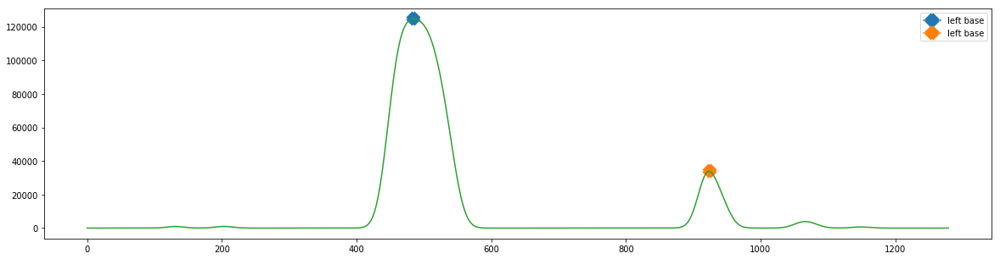

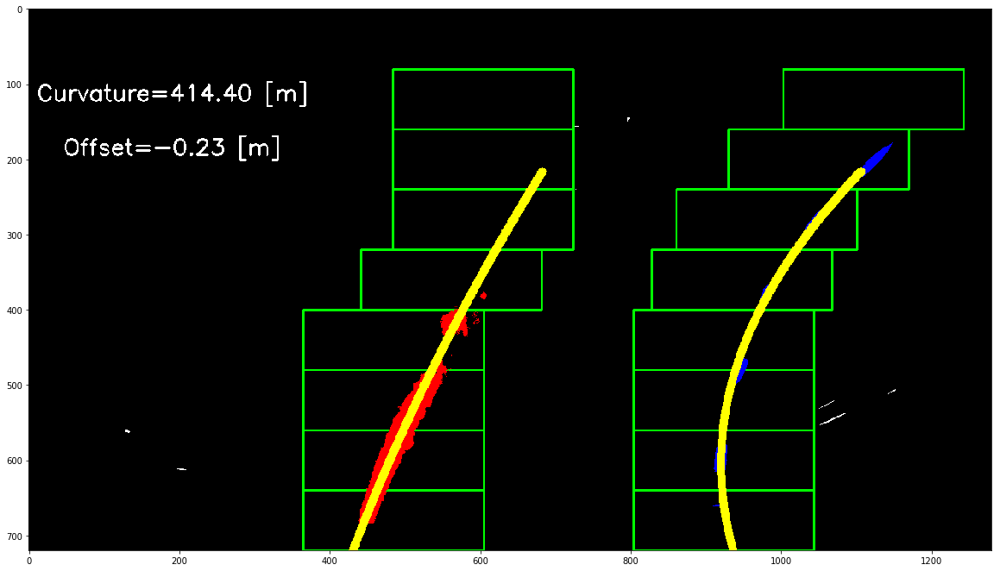

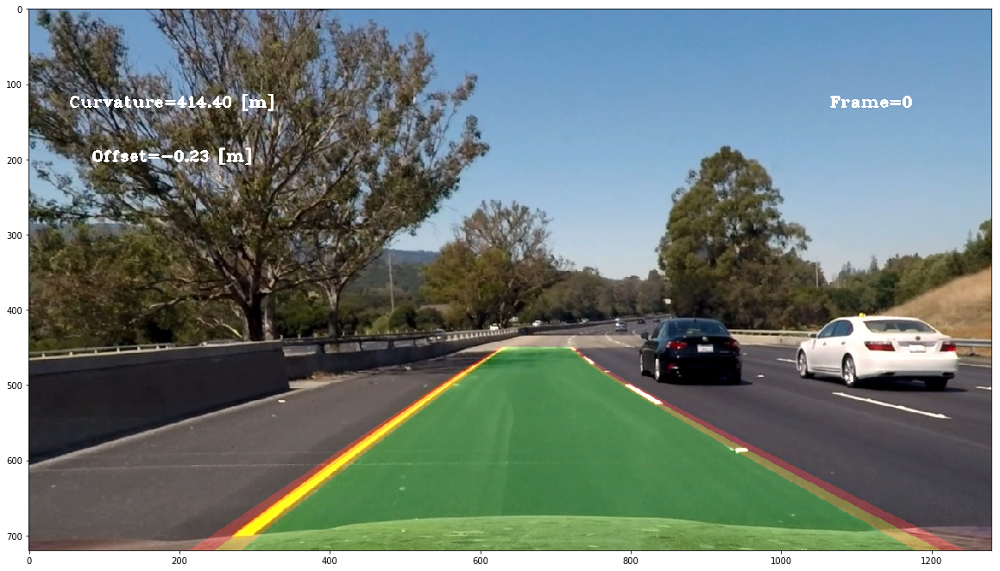

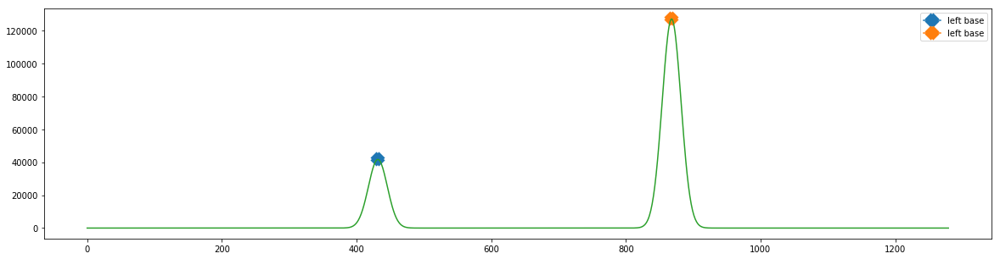

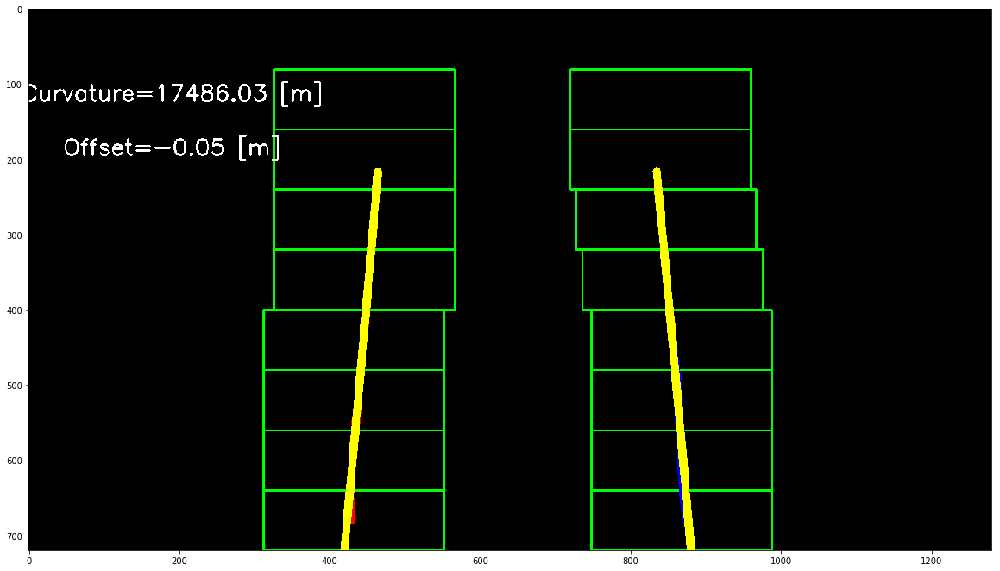

...

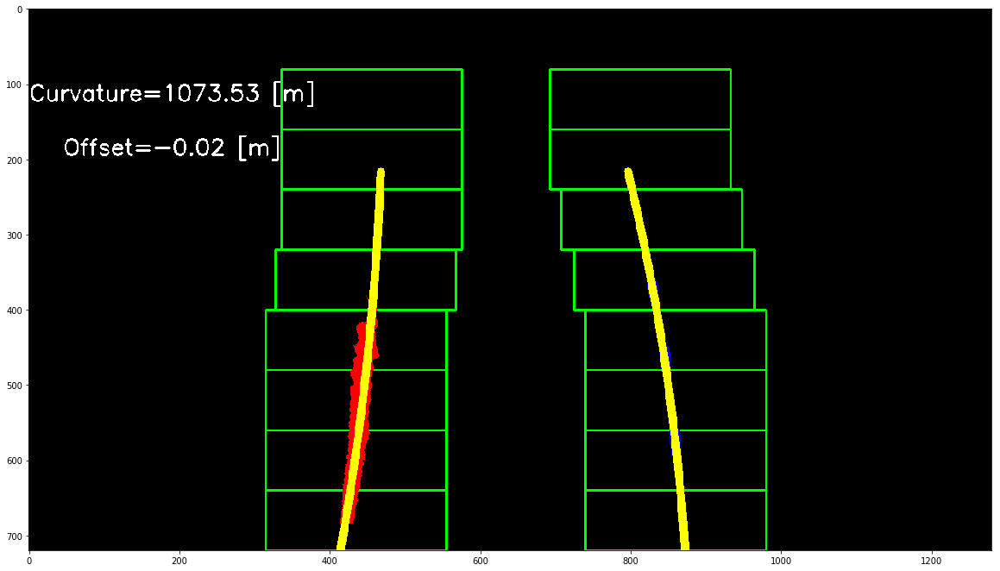

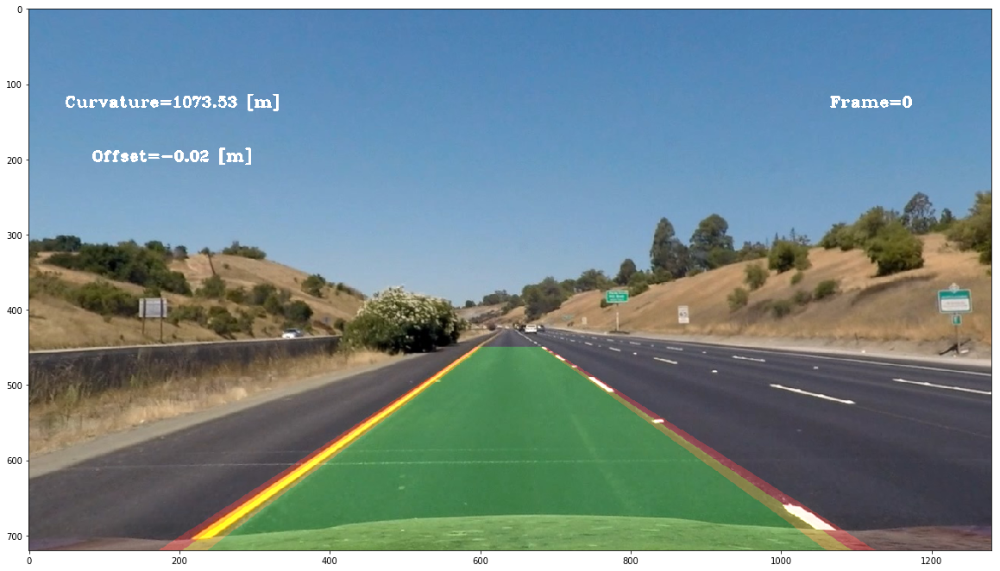

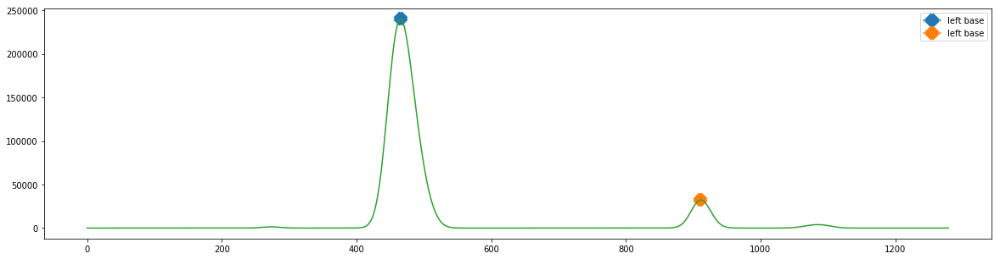

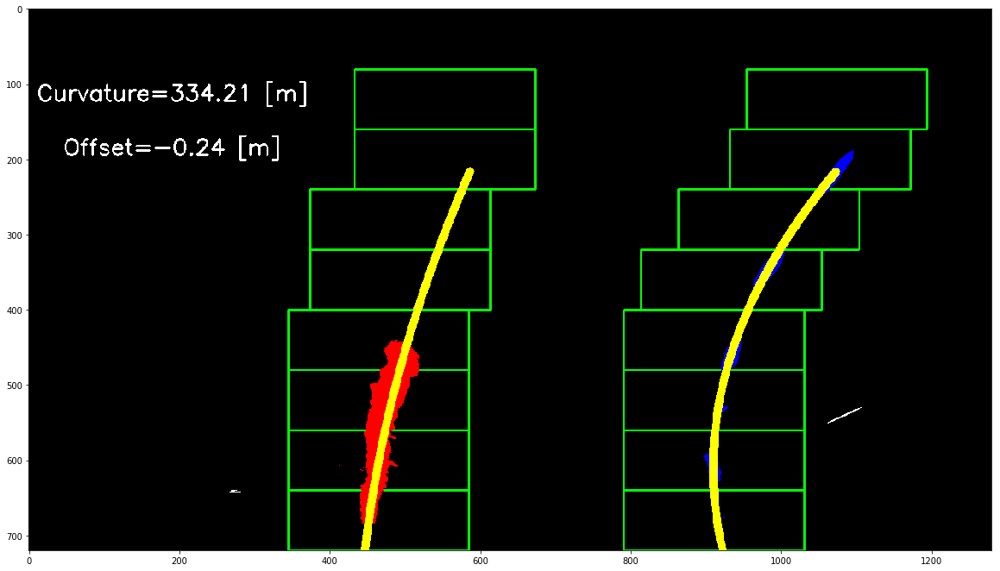

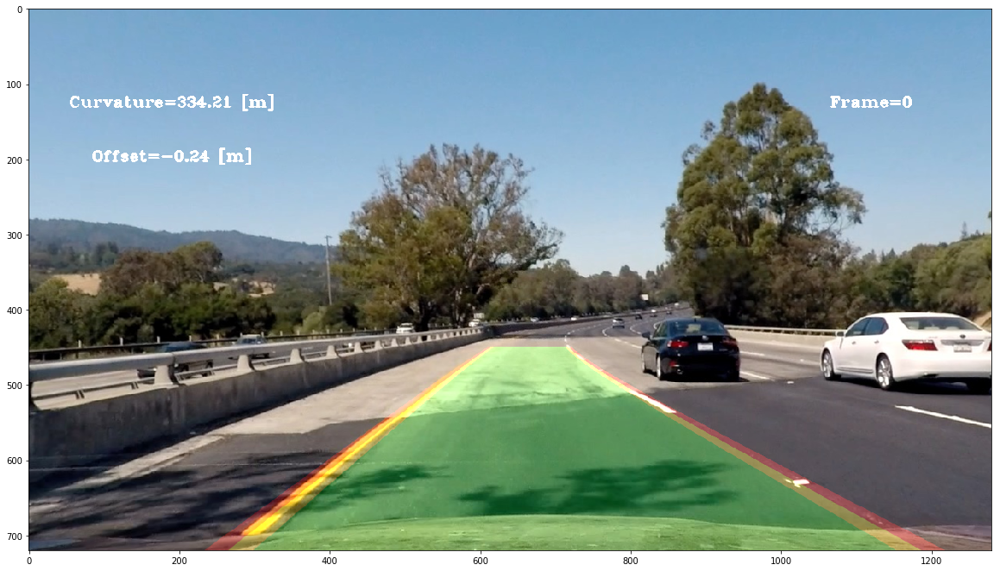

In [55]:
class Pipeline(object):

    nframe = 0

    def __init__(self, save=False, show=False, 
                 trapezoid_params=trapezoid_params, trapezoid_params_flat=trapezoid_params_flat,
                car_hood=0.08, road_height=0.4):
        
        self.show = show
        self.save = save
        self.car_hood = car_hood
        self.road_height = road_height
        
        self.undistort = Rectification(distortion_file=calibration_cache_file, show=False, save=False)
        self.trapezoid_params = trapezoid_params #{"x_l": 0.1, "x_h": 0.45, "y_h":0.95, "y_l": 0.6}

        self.trapezoid_params_flat = trapezoid_params_flat #{"x_l": 0.1, "x_h": 0.1, "y_h":0.9, "y_l": 0.0}

        #trapezoid_params = {"x_l": 2.5, "x_h": 0.3, "y_h":0.95, "y_l": 0.0}
        self.mask_pipeline = MaskPipeline(show=False, save=False, trapezoid_params=trapezoid_params_flat)



        self.localizer = Localization(save=save, show=show, nimage=6)
        self.bird_eye = None
    
    def get_lanes(self, img):

        undistorted_img = self.undistort.rectify(img)
        
        birdeye_view = self.bird_eye.transform(undistorted_img)

        roi_mask = self.mask_pipeline.process(img=birdeye_view, img_file=img_file, sobel_anomaly_th=sobel_anomaly_percentile, 
                                 l_intensity_anomaly_th=l_intensity_anomaly_percentile, b_intensity_anomaly_th=b_intensity_anomaly_percentile)

                                     
                 
        #         roi_mask = mask_pipeline.region_of_interest(birdeye_view, self.trapezoid_params_flat)
            
        right_fit, left_fit, curvature, offset, laned_img = self.localizer.localize(roi_mask, img_file)

        laned_img = self.bird_eye.inv_transform(laned_img)
        laned_img = cv2.addWeighted(np.uint8(undistorted_img), 1, np.uint8(laned_img), 0.25, 0)

        return laned_img, right_fit, left_fit, curvature, offset

    def add_meta_data(self, img, curvature, offset):
        font = cv2.FONT_HERSHEY_COMPLEX_SMALL
        curv_text = "Curvature={:4.2f} [m]".format(curvature)
        textsize = cv2.getTextSize(curv_text, font, 1, 2)[0]
        textX = int((img.shape[1] * 0.3 - textsize[0]) / 2)
        textY = int(img.shape[0] * 0.2 - textsize[1])
        cv2.putText(img, curv_text, (textX, textY ), font, 1, (255, 255, 255), 2)

        offset_text = "Offset={:4.2f} [m]".format(offset)
        textsize = cv2.getTextSize(offset_text, font, 1, 2)[0]
        textX = int((img.shape[1] * 0.3 - textsize[0]) / 2)
        textY = int(img.shape[0] * 0.3 - textsize[1])
        cv2.putText(img, offset_text, (textX, textY), font, 1, (255, 255, 255), 2)

        frame_text = "Frame={}".format(self.nframe)
        textsize = cv2.getTextSize(offset_text, font, 1, 2)[0]
        textX = int((img.shape[1] - textsize[0]))
        textY = int(img.shape[0] * 0.2 - textsize[1])
        cv2.putText(img, frame_text, (textX, textY), font, 1, (255, 255, 255), 2)

    def process_image(self, img):
        if self.bird_eye is None:
            Y, X = img.shape[:2]
            self.bird_eye = BirdEye(shape=(X, Y), car_hood=self.car_hood, road_height=self.road_height)

        laned_img, right_fit, left_fit, curvature, offset = self.get_lanes(img)
        self.add_meta_data(laned_img, curvature, offset)
        
        self.nframe += 1

        if self.show:
            plt.figure(figsize=(20,20))
            plt.imshow(laned_img)

        return laned_img

if True:
    for img_file in glob.glob('test_images/*.jpg'):
        pipeline = Pipeline(show=True)
        img = mpimg.imread(img_file)
        laned_img = pipeline.process_image(img)

# vid = 'challenge_video.mp4'

# nframe = 2
# video = VideoFileClip(vid)
# img = video.get_frame(nframe*1.0/video.fps)


# # img_file = glob.glob('test_images/*.jpg')[7]
# # img = mpimg.imread(img_file)
    
# pipeline = Pipeline(save=False, show=True)
# laned_img = pipeline.process_image(img)

    



# Selected Video Frames

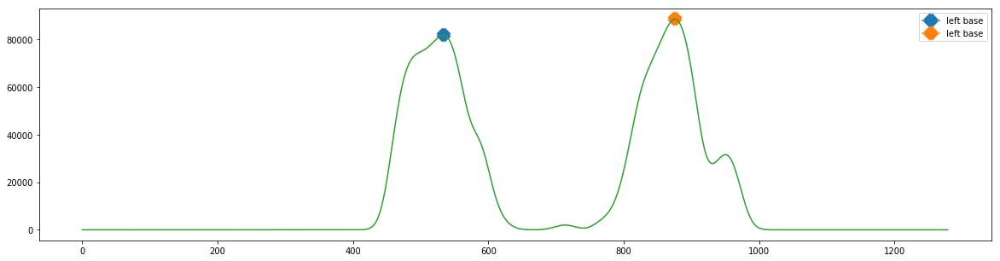

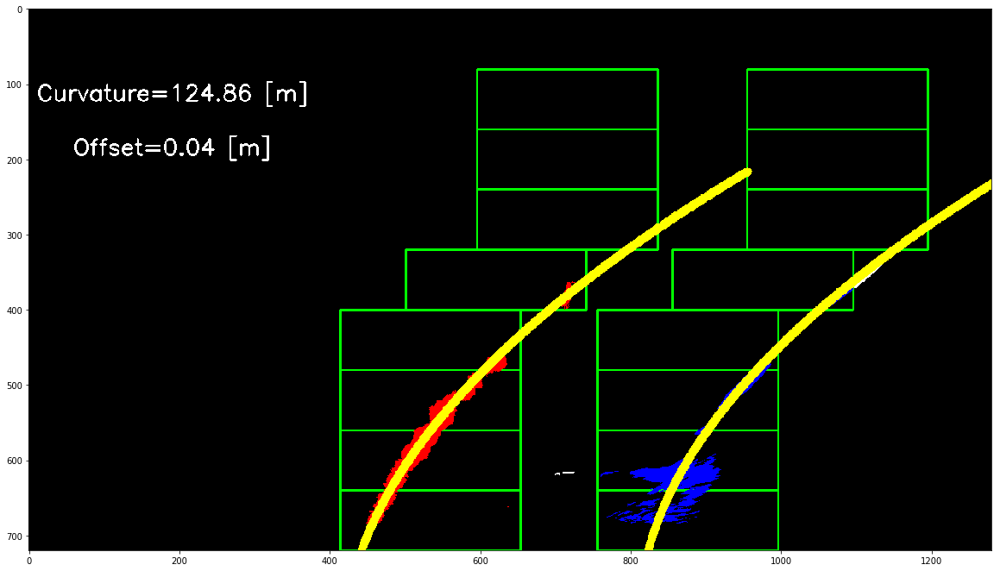

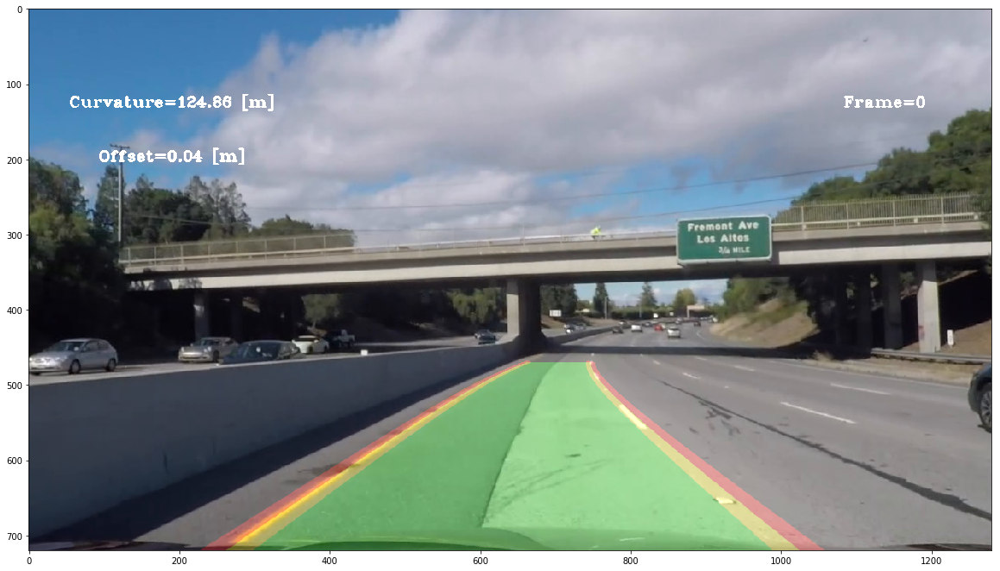

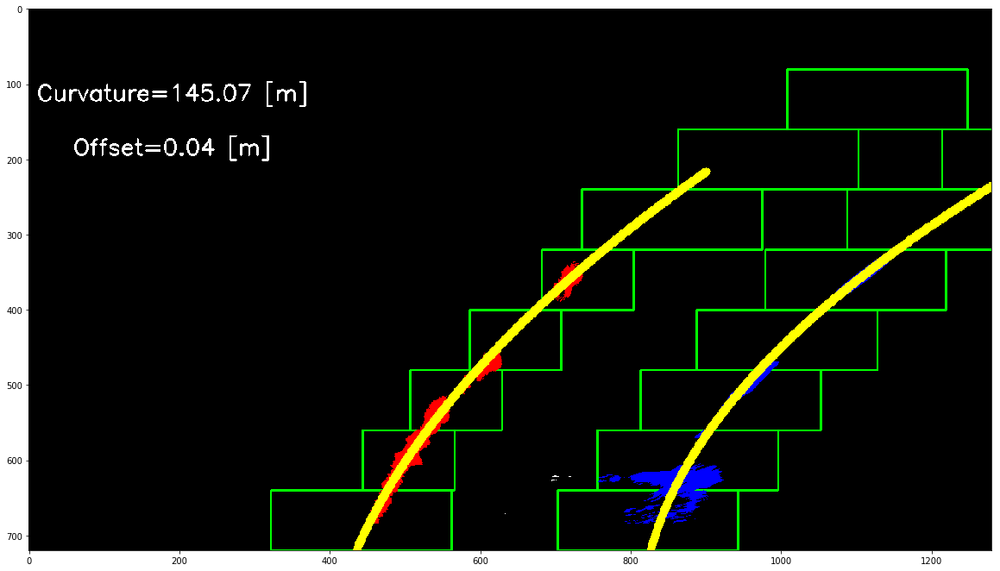

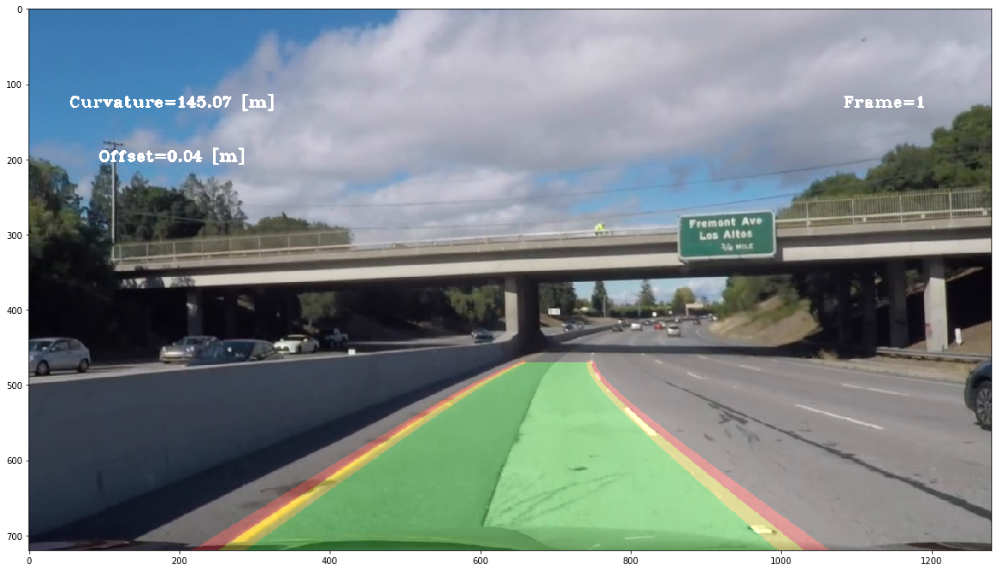

...

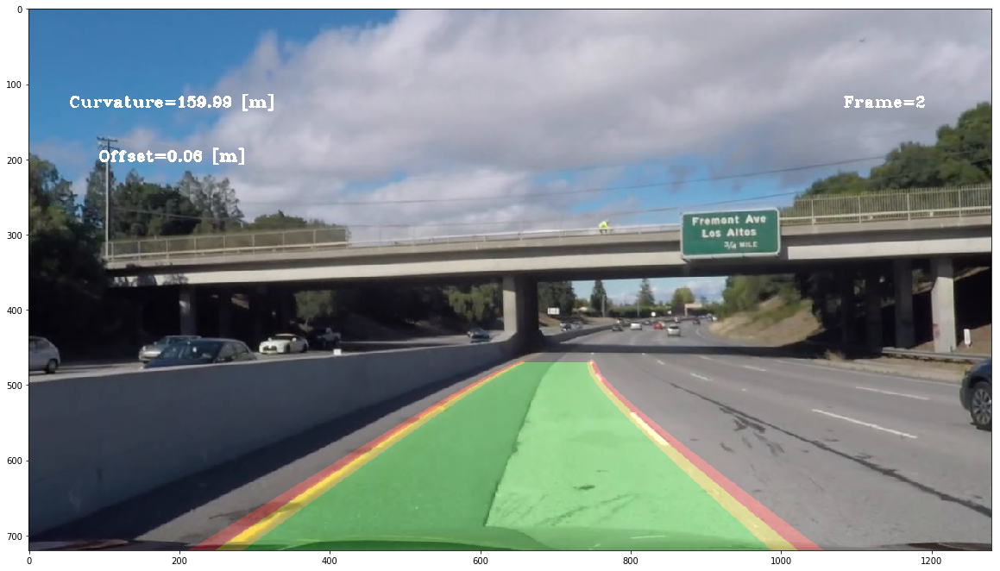

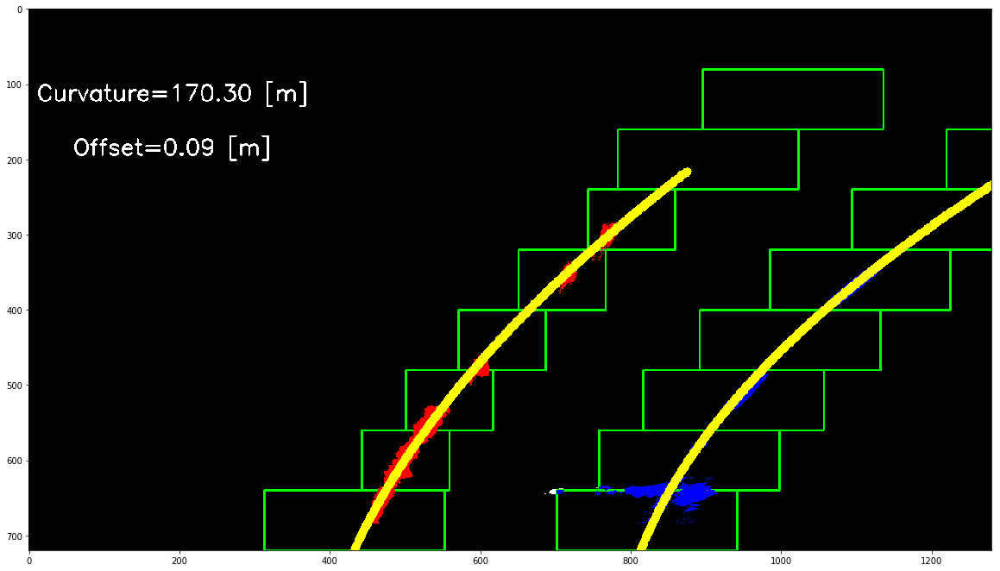

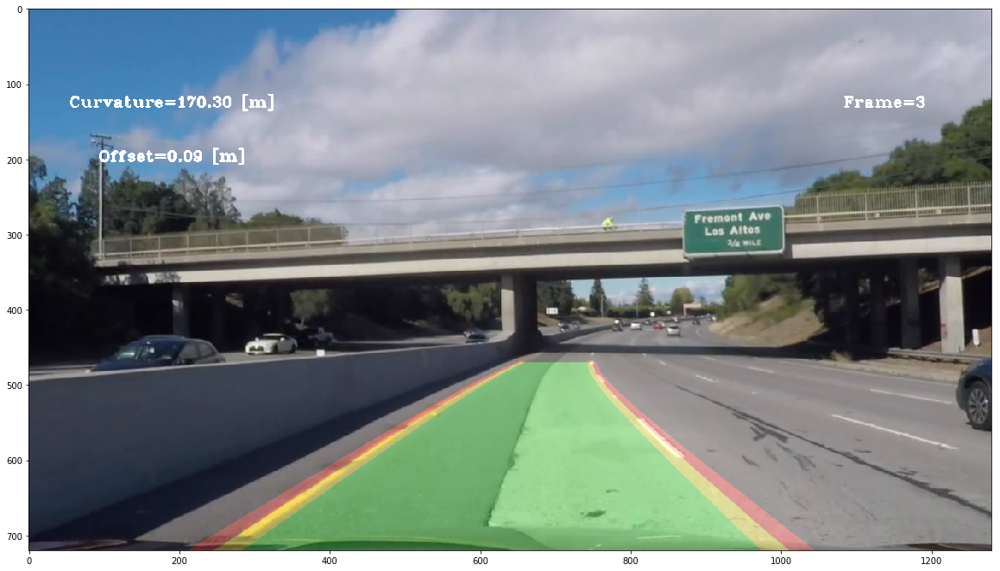

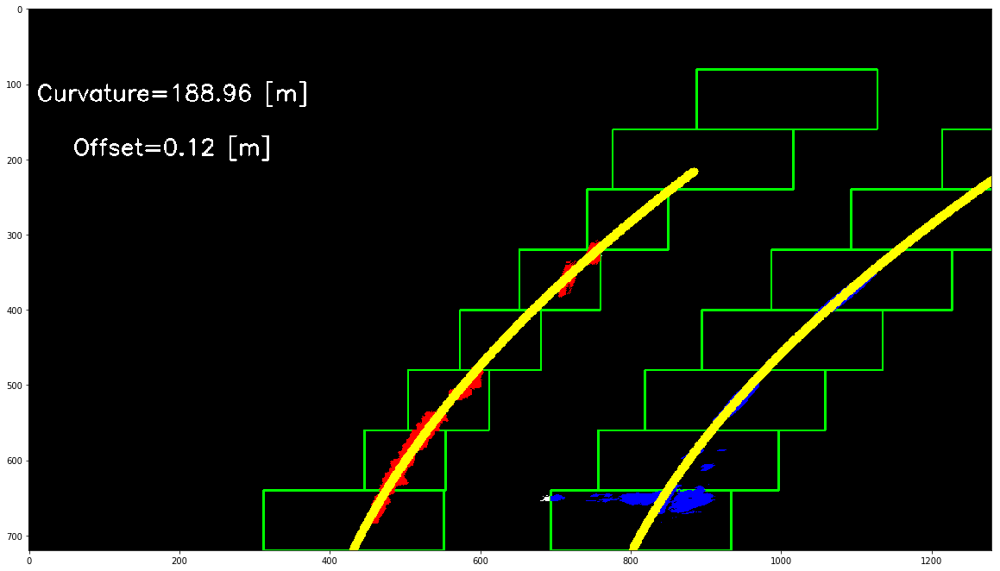

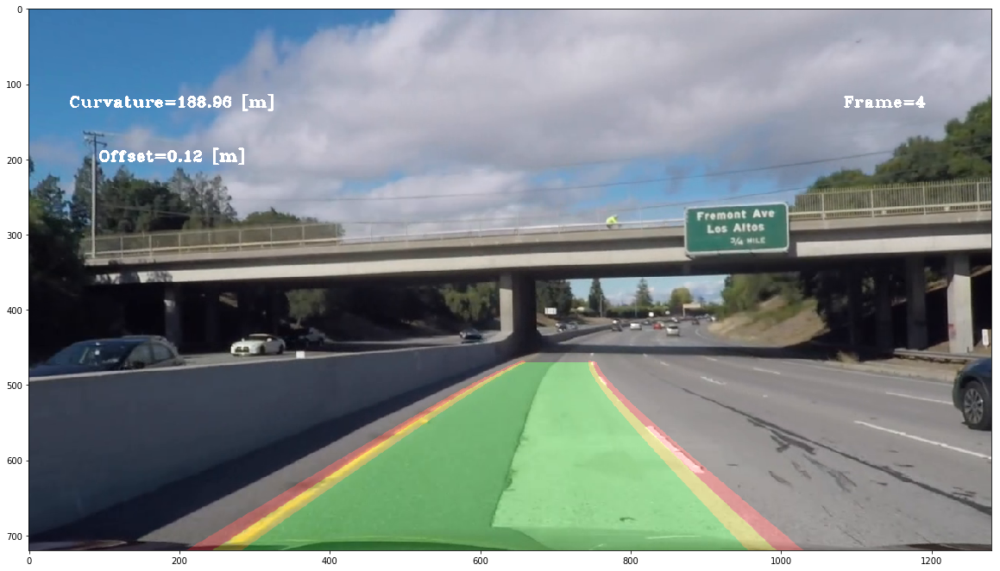

In [45]:
# vid = 'harder_challenge_video.mp4'
vid = 'challenge_video.mp4'
# vid = 'project_video.mp4'
# nframe=172
# nframe=608
# nframe = 1010
nframe = 80
video = VideoFileClip(vid)
# video = VideoFileClip('challenge_video.mp4')
# video = VideoFileClip('project_video.mp4')
#image = video.get_frame(5.6)

pipeline = Pipeline(save=False, show=True, road_height=0.37)
# pipeline = Pipeline(save=False, show=True)

for i in range(5):
# laned_image = pipeline.process_image(video.get_frame(nframe*1.0/video.fps))
    laned_image = pipeline.process_image(video.get_frame((nframe+i)*1.0/video.fps))


# Video tests

In [58]:
try:
    del clip2
except:
    pass

try:
    del video
except:
    pass



clip2 = VideoFileClip('project_video.mp4')
pipeline = Pipeline()

clip = clip2.fl_image(pipeline.process_image)
%time clip.write_videofile('project_video_out.mp4', audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4





  0%|          | 0/1261 [00:00<?, ?it/s]


  0%|          | 1/1261 [00:00<05:28,  3.84it/s]


  0%|          | 2/1261 [00:00<05:41,  3.69it/s]


  0%|          | 3/1261 [00:00<05:41,  3.69it/s]


  0%|          | 4/1261 [00:01<05:41,  3.68it/s]


  0%|          | 5/1261 [00:01<05:41,  3.68it/s]


  0%|          | 6/1261 [00:01<05:42,  3.67it/s]


  1%|          | 7/1261 [00:01<05:40,  3.68it/s]


  1%|          | 8/1261 [00:02<05:40,  3.68it/s]


  1%|          | 9/1261 [00:02<05:44,  3.64it/s]


  1%|          | 10/1261 [00:02<05:45,  3.63it/s]


  1%|          | 11/1261 [00:03<05:43,  3.64it/s]


  1%|          | 12/1261 [00:03<05:47,  3.59it/s]


  1%|          | 13/1261 [00:03<05:49,  3.57it/s]


  1%|          | 14/1261 [00:03<05:51,  3.55it/s]


  1%|          | 15/1261 [00:04<05:50,  3.56it/s]


  1%|▏         | 16/1261 [00:04<05:52,  3.53it/s]


  1%|▏         | 17/1261 [00:04<05:52,  3.53it/s]


  1%|▏         | 18/1261 [00:05<05:52,  3.53it/s]


  2%|▏         | 19/1261 [0

[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 38min 49s, sys: 14.9 s, total: 39min 4s
Wall time: 7min 20s


In [ ]:
clip2 = VideoFileClip('challenge_video_short.mp4')
pipeline = Pipeline(road_height=0.37)

clip = clip2.fl_image(pipeline.process_image)
%time clip.write_videofile('challenge_video_out.mp4', audio=False)



# References & Ideas


- Gimp white balance algorithm -  [GIMP's White balance](https://pippin.gimp.org/image-processing/chapter-automaticadjustments.html)

- HSV/HSL filtering -[HSV filtering in lane finding example](https://github.com/Kidra521/carnd/blob/master/p1_lane_lines_detection/P1.ipynb) 

    A different colorspace, in which HSV colorpsace has been used. HSV (or HSL) are more device specific. 
    Also, there has been usage of fixed, non adaptive thresholding

